In [1]:
%load_ext autoreload
%autoreload 2

In [47]:
from pathlib import Path
from os import path
import numpy as np
import pandas as pd
from scipy.stats import linregress, spearmanr
import matplotlib.pyplot as plt
import pickle
import mne
from mni_utils import convert_knee_tau
import statsmodels.formula.api as smf

import statsmodels.api as sm

### Paths and Params

In [8]:
base_path = Path("F:\iEEG_neural_dynamics\MNIOpen")
res_path = base_path.joinpath("Results")


## Correlations knee - tau

Per parcel:

In [9]:
df_tau = pd.read_csv(res_path.joinpath("tau_parc_W.csv"), index_col=0)
df_knee = pd.read_csv(base_path.joinpath("df_tau_avg.csv"), index_col=0)

In [10]:
df_knee

,tau,logtau
V1,17.369645,1.239791
MST,14.266527,1.154318
V6,14.733831,1.168316
V2,18.599167,1.269493
V3,17.063109,1.232058
...,...,...
STSva,25.228751,1.401896
TE1m,23.949567,1.379298
PI,21.616940,1.334794
a32pr,27.377661,1.437396


LinregressResult(slope=37.066176821791665, intercept=-21.066884304871973, rvalue=0.8403085460956862, pvalue=3.2962421157293886e-49, stderr=1.7923184298557568, intercept_stderr=2.360978625278631)
SignificanceResult(statistic=0.8589771289237322, pvalue=1.2400684957064912e-53)


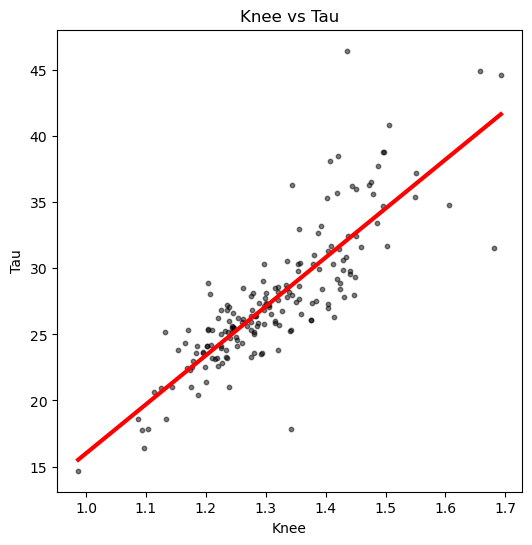

In [18]:
x = df_knee["logtau"].to_numpy()
y = df_tau.loc[df_knee.index].to_numpy().squeeze()

res = linregress(x, y)
print(res)
print(spearmanr(x, y))

plt.figure(figsize=(6, 6))
plt.scatter(x, y, c="k", alpha=0.5, s=10)
plt.plot(
    [x.min(), x.max()],
    [
        res.intercept + res.slope * x.min(),
        res.intercept + res.slope * x.max(),
    ],
    "r",
    linewidth=3,
)
plt.xlabel("Knee")
plt.ylabel("Tau")
plt.title("Knee vs Tau")
plt.show()

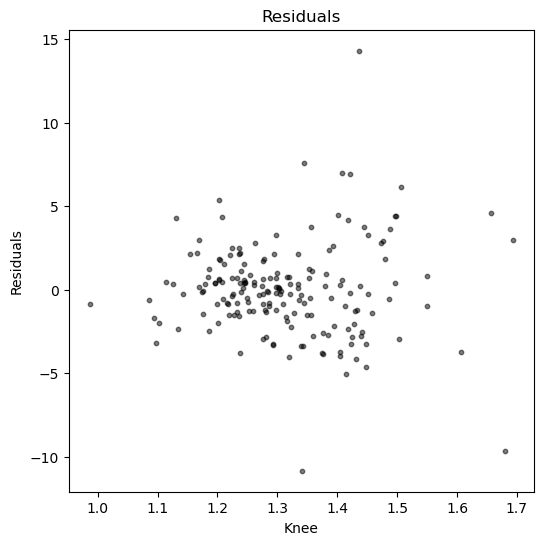

In [21]:
residuals = y - (res.intercept + res.slope * x)
plt.figure(figsize=(6, 6))
plt.scatter(x, residuals, c="k", alpha=0.5, s=10)
plt.xlabel("Knee")  
plt.ylabel("Residuals")
plt.title("Residuals")
plt.show()

In [22]:
pd.DataFrame(residuals, index=df_knee.index, columns=["diff"]).sort_values("diff")

,diff
10d,-10.837766
EC,-9.678618
i6-8,-5.055582
47l,-4.612748
p47r,-4.141142
...,...
pOFC,6.132411
9m,6.954006
8BM,7.012287
9p,7.562965


Single electrodes:

In [24]:
df_tau = pd.read_csv(res_path.joinpath("all_tau.csv"), index_col=0)
df_tau = df_tau[df_tau["stage"] == "W"]
# df_knee = pd.read_csv(res_path.joinpath("all_knee.csv"), index_col=0)
df_knee = pd.read_csv(base_path.joinpath("df_human.csv"), index_col=0)

print(df_tau.shape)
print(df_knee.shape)

(1772, 11)
(1722, 16)


In [25]:
df_tau[(df_tau["mni_x"].isin(df_knee["x"])) & (df_tau["mni_y"].isin(df_knee["y"])) & (df_tau["mni_z"].isin(df_knee["z"]))].shape

(1759, 11)

In [32]:
df_tau

,pat,age,gender,chan,type,stage,region,mni_x,mni_y,mni_z,tau
0,1,34,['M'],GD001Lc_11,D,W,Middle temporal gyrus,-56.000000,-37.000000,-2.000000,15.477081
1,1,34,['M'],GD001Lc_12,D,W,Middle temporal gyrus,-60.000000,-37.000000,-4.000000,15.450481
2,1,34,['M'],GD001Lc_13,D,W,Middle temporal gyrus,-63.000000,-37.000000,-2.000000,15.336807
3,1,34,['M'],GD001Lc_14,D,W,Middle temporal gyrus,-68.000000,-38.000000,-2.000000,17.656101
4,1,34,['M'],GD001Lo_1,D,W,Medial frontal cortex,-1.000000,42.000000,-14.000000,22.687393
...,...,...,...,...,...,...,...,...,...,...,...
7053,110,27,['F'],NG110RG614,G,W,Postcentral gyrus (including medial segment),64.958333,-6.500000,13.666667,25.242406
7054,110,27,['F'],NG110RG64,G,W,Frontal operculum,48.464286,27.464286,-1.285714,24.641900
7055,110,27,['F'],NG110RG65,G,W,Frontal operculum,52.535714,15.035714,-0.214286,25.047029
7056,110,27,['F'],NG110RI101,G,W,Supplementary motor cortex,1.035714,-2.047619,48.380952,18.226162


In [44]:
idx_same = []
for pat in df_tau.pat.unique():
    df_tau_pat = df_tau[df_tau["pat"] == pat]
    df_knee_pat = df_knee[df_knee["patient"] == pat]
    for i, row in df_tau_pat.iterrows():
        if row[["mni_x", "mni_y", "mni_z"]].to_list() in df_knee_pat.loc[:, ["x", "y", "z"]].to_numpy().tolist():
            idx_same.append(i)

In [46]:
df_tau.loc[idx_same]

,pat,age,gender,chan,type,stage,region,mni_x,mni_y,mni_z,tau
0,1,34,['M'],GD001Lc_11,D,W,Middle temporal gyrus,-56.000000,-37.000000,-2.000000,15.477081
1,1,34,['M'],GD001Lc_12,D,W,Middle temporal gyrus,-60.000000,-37.000000,-4.000000,15.450481
2,1,34,['M'],GD001Lc_13,D,W,Middle temporal gyrus,-63.000000,-37.000000,-2.000000,15.336807
3,1,34,['M'],GD001Lc_14,D,W,Middle temporal gyrus,-68.000000,-38.000000,-2.000000,17.656101
4,1,34,['M'],GD001Lo_1,D,W,Medial frontal cortex,-1.000000,42.000000,-14.000000,22.687393
...,...,...,...,...,...,...,...,...,...,...,...
7053,110,27,['F'],NG110RG614,G,W,Postcentral gyrus (including medial segment),64.958333,-6.500000,13.666667,25.242406
7054,110,27,['F'],NG110RG64,G,W,Frontal operculum,48.464286,27.464286,-1.285714,24.641900
7055,110,27,['F'],NG110RG65,G,W,Frontal operculum,52.535714,15.035714,-0.214286,25.047029
7056,110,27,['F'],NG110RI101,G,W,Supplementary motor cortex,1.035714,-2.047619,48.380952,18.226162


LinregressResult(slope=0.5706501614308421, intercept=14.418252481011704, rvalue=0.7248978963962792, pvalue=1.0113226201676572e-280, stderr=0.013075476769713153, intercept_stderr=0.3269666025781832)
SignificanceResult(statistic=0.824311256900075, pvalue=0.0)


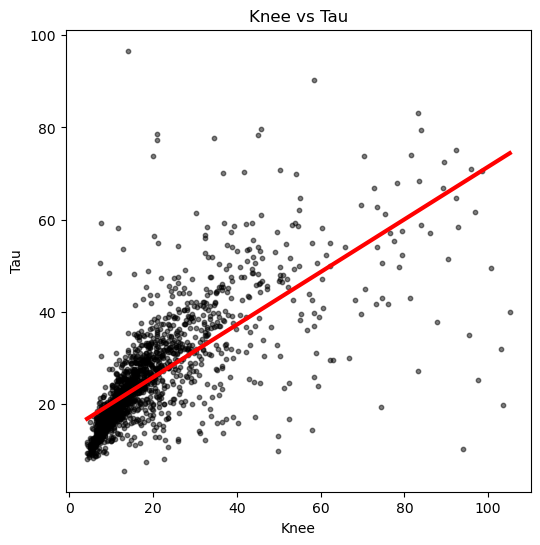

In [54]:
x = df_knee["tau"].to_numpy() * 1000
y = df_tau.loc[idx_same, "tau"].to_numpy()

# rlm_model = sm.RLM(y, sm.add_constant(x))
# res = rlm_model.fit()
# print(res.summary())

res = linregress(x, y)
print(res)
print(spearmanr(x, y))

plt.figure(figsize=(6, 6))
plt.scatter(x, y, c="k", alpha=0.5, s=10)
plt.plot(
    [x.min(), x.max()],
    [
        res.intercept + res.slope * x.min(),
        res.intercept + res.slope * x.max(),
    ],
    "r",
    linewidth=3,
)
plt.xlabel("Knee")
plt.ylabel("Tau")
plt.title("Knee vs Tau")
plt.show()

In [6]:
df_knee = df_knee[(df_knee["tau"] < 500) & (df_knee["tau"].notna())]
# df_knee = df_knee.dropna()
df_tau = df_tau[df_tau.index.isin(df_knee.index)]

LinregressResult(slope=0.34033253620621695, intercept=29.99595458735471, rvalue=0.6243862472232283, pvalue=0.0, stderr=0.005712978613928736, intercept_stderr=0.4584611974718534)
SignificanceResult(statistic=0.8144392500038432, pvalue=0.0)


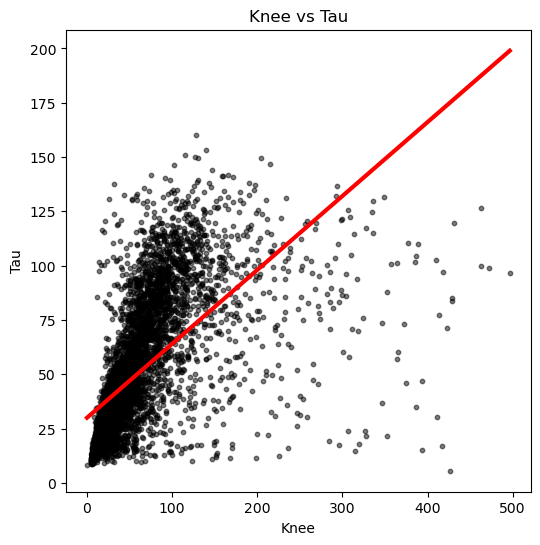

In [15]:
res = linregress(df_knee["tau"].to_numpy(), df_tau["tau"].to_numpy())
print(res)
print(spearmanr(df_knee["tau"].to_numpy(), df_tau["tau"].to_numpy()))

plt.figure(figsize=(6, 6))
plt.scatter(df_knee["tau"].to_numpy(), df_tau["tau"].to_numpy(), c="k", alpha=0.5, s=10)
plt.plot(
    [df_knee["tau"].min(), df_knee["tau"].max()],
    [
        res.intercept + res.slope * df_knee["tau"].min(),
        res.intercept + res.slope * df_knee["tau"].max(),
    ],
    "r",
    linewidth=3,
)
plt.xlabel("Knee")
plt.ylabel("Tau")
plt.title("Knee vs Tau")
plt.show()


Robust

In [16]:
import statsmodels.api as sm

rlm_model = sm.RLM(df_knee["tau"].to_numpy(), sm.add_constant(df_tau["tau"].to_numpy()))
rlm_results = rlm_model.fit()

print(rlm_results.params)


[-3.35388887  1.0457407 ]


In [17]:
rlm_results.summary()


<class 'statsmodels.iolib.summary.Summary'>
"""
                    Robust linear Model Regression Results                    
==============================================================================
Dep. Variable:                      y   No. Observations:                 5556
Model:                            RLM   Df Residuals:                     5554
Method:                          IRLS   Df Model:                            1
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Mon, 15 Jan 2024                                         
Time:                        14:40:02                                         
No. Iterations:                    33                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -3.3539      0.423     -7.935      0.000      -4.182      -2.525
x1             1.0457      0.007    144.007      0.000       1.032       1.060
==============================================================================

If the model instance has been used for another fit with different fit parameters, then the fit options might not be the correct ones anymore .
"""

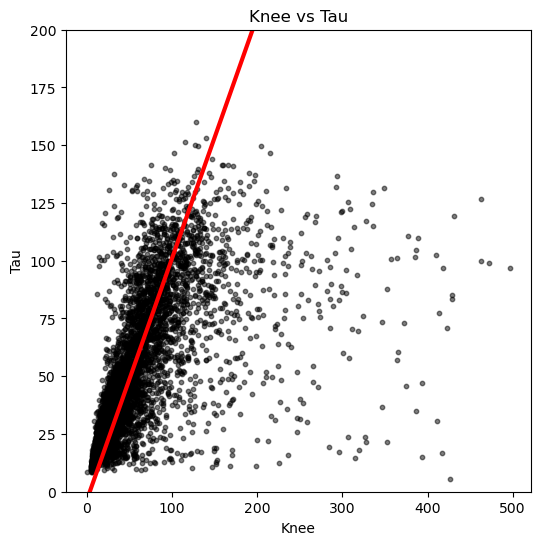

In [18]:
plt.figure(figsize=(6, 6))
plt.scatter(df_knee["tau"].to_numpy(), df_tau["tau"].to_numpy(), c="k", alpha=0.5, s=10)
plt.plot(
    [df_knee["tau"].min(), df_knee["tau"].max()],
    [
        rlm_results.params[0] + rlm_results.params[1] * df_knee["tau"].min(),
        rlm_results.params[0] + rlm_results.params[1] * df_knee["tau"].max(),
    ],
    "r",
    linewidth=3,
)
plt.ylim(0, 200)
plt.xlabel("Knee")
plt.ylabel("Tau")
plt.title("Knee vs Tau")
plt.show()


Per sleep stage

W
LinregressResult(slope=0.14186463775456595, intercept=21.83233851512029, rvalue=0.47981354132667725, pvalue=3.008832072819366e-100, stderr=0.0062422118532174204, intercept_stderr=0.3491398450990471)
SignificanceResult(statistic=0.699858393389729, pvalue=1.1763600551574204e-254)


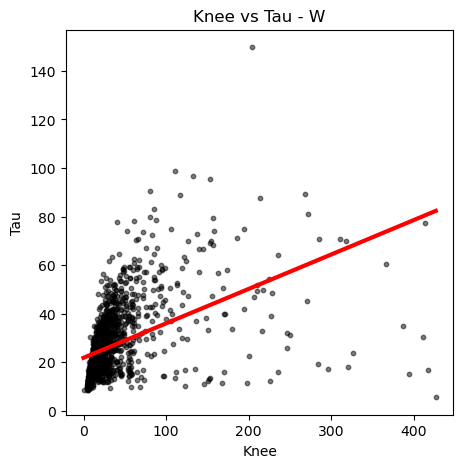

N2
LinregressResult(slope=0.25223027346746113, intercept=36.436067423937835, rvalue=0.604589044146949, pvalue=1.1447964066216545e-142, stderr=0.008812383731005319, intercept_stderr=0.7254963434825162)
SignificanceResult(statistic=0.7899371148899987, pvalue=2.4303312287421512e-304)


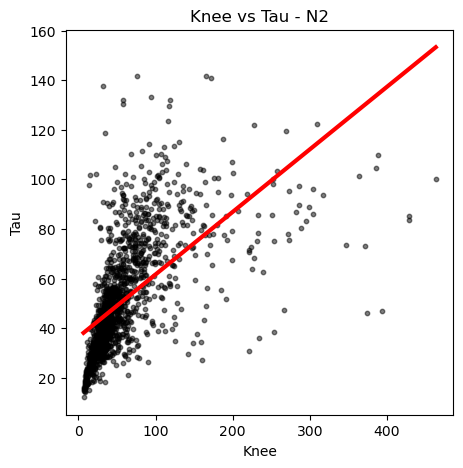

N3
LinregressResult(slope=0.26407171969981397, intercept=60.39533827540514, rvalue=0.566066546468499, pvalue=1.0906976581197183e-121, stderr=0.010187406704715504, intercept_stderr=1.0817556405214626)
SignificanceResult(statistic=0.709180267422124, pvalue=1.46982276459411e-218)


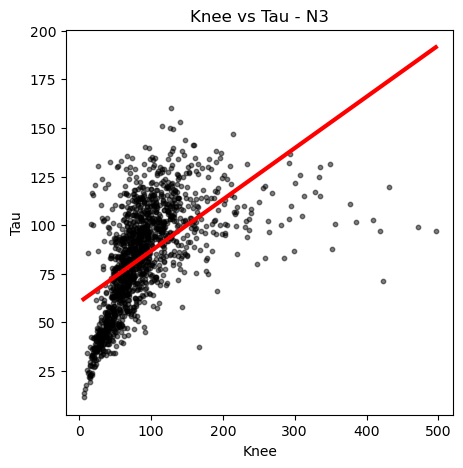

R
LinregressResult(slope=0.1896001645083183, intercept=26.93818007275329, rvalue=0.48323550317496944, pvalue=2.9839817205036275e-58, stderr=0.011006564618919128, intercept_stderr=0.7580611776763998)
SignificanceResult(statistic=0.6134346075757556, pvalue=5.90948354941972e-102)


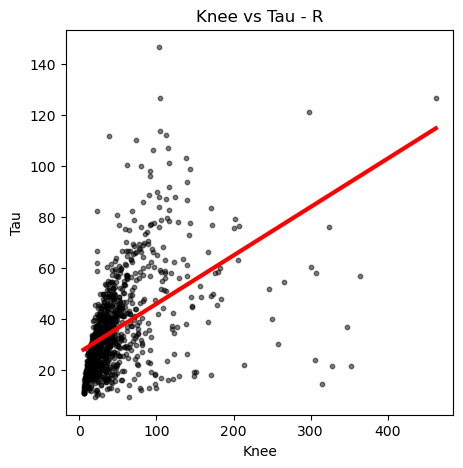

In [19]:
for stage in df_knee.stage.unique():
    df_knee_stage = df_knee[df_knee.stage == stage]
    df_tau_stage = df_tau[df_tau.stage == stage]
    print(stage)

    res = linregress(df_knee_stage["tau"].to_numpy(), df_tau_stage["tau"].to_numpy())
    print(res)
    print(spearmanr(df_knee_stage["tau"].to_numpy(), df_tau_stage["tau"].to_numpy()))

    plt.figure(figsize=(5, 5))
    plt.scatter(
        df_knee_stage["tau"].to_numpy(),
        df_tau_stage["tau"].to_numpy(),
        c="k",
        alpha=0.5,
        s=10,
    )
    plt.plot(
        [df_knee_stage["tau"].min(), df_knee_stage["tau"].max()],
        [
            res.intercept + res.slope * df_knee_stage["tau"].min(),
            res.intercept + res.slope * df_knee_stage["tau"].max(),
        ],
        "r",
        linewidth=3,
    )
    plt.xlabel("Knee")
    plt.ylabel("Tau")
    plt.title("Knee vs Tau - " + stage)
    plt.show()

## Check correlations of exponent at 20-40 Hz and 30-45 Hz

In [16]:
df_exp_20_40 = pd.read_csv(base_path.joinpath("Results_psd_exp/all_knee.csv"), index_col=0)
df_exp_30_45 = pd.read_csv(base_path.joinpath("Results_psd_exp_30-45/all_knee.csv"), index_col=0)
df_exp_20_40 = df_exp_20_40.dropna(subset="exp")
df_exp_30_45 = df_exp_30_45[df_exp_30_45.index.isin(df_exp_20_40.index)]


Linregress LinregressResult(slope=0.568567005162766, intercept=1.5965753783955827, rvalue=0.5399324321308159, pvalue=0.0, stderr=0.011721462571212465, intercept_stderr=0.03464500406446554)
Spearman SignificanceResult(statistic=0.5538866019286989, pvalue=0.0)


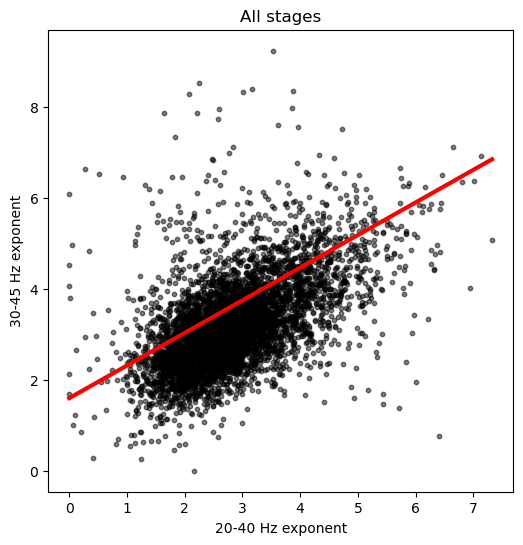

Linregress LinregressResult(slope=0.5080103203983076, intercept=1.8862322936435953, rvalue=0.46881326374928717, pvalue=1.6415207915808941e-97, stderr=0.02275060318766862, intercept_stderr=0.0763361171190551)
Spearman SignificanceResult(statistic=0.5394893329313499, pvalue=2.1918419436981433e-134)


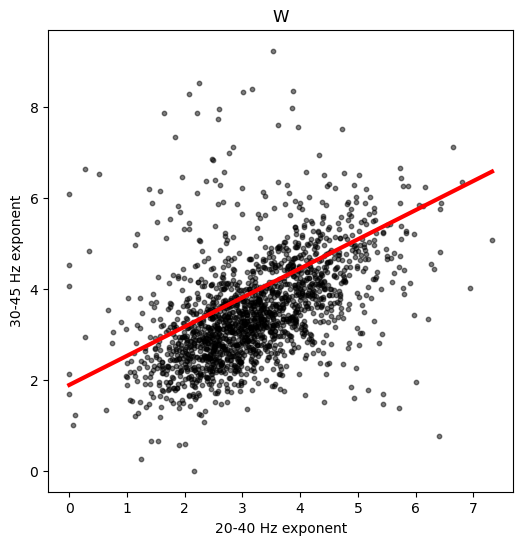

Linregress LinregressResult(slope=0.6349109829743148, intercept=1.2916102550415285, rvalue=0.5602961798030607, pvalue=4.2360042666230755e-122, stderr=0.02451386754914745, intercept_stderr=0.06359479134406762)
Spearman SignificanceResult(statistic=0.495759577300629, pvalue=6.756502458576342e-92)


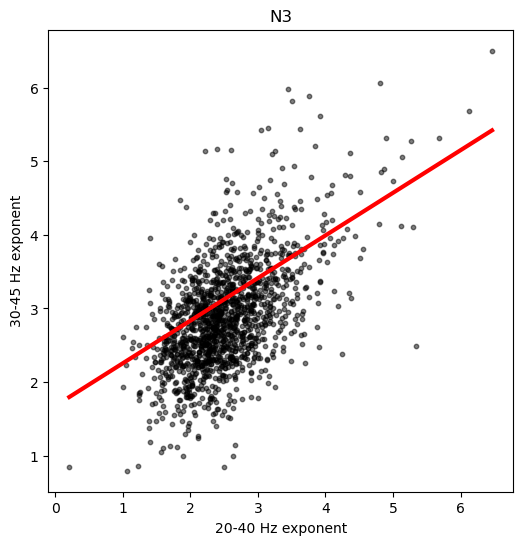

Linregress LinregressResult(slope=0.47601361675495807, intercept=1.8887474800085184, rvalue=0.4689912666794149, pvalue=1.7702781407704856e-56, stderr=0.02820683594515219, intercept_stderr=0.08243743145293884)
Spearman SignificanceResult(statistic=0.4852833919997561, pvalue=6.575595150173097e-61)


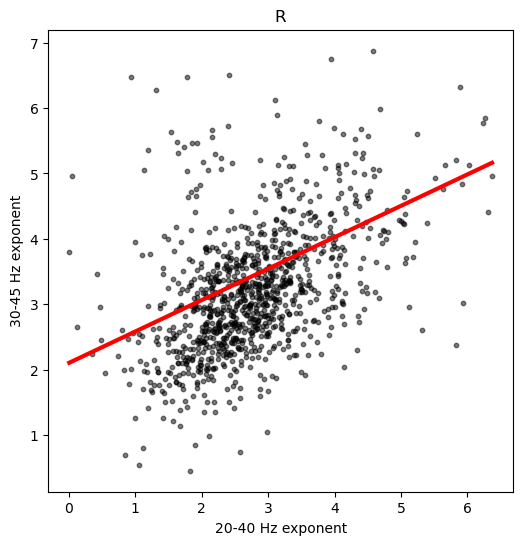

In [17]:
# All stages
x = df_exp_20_40["exp"].to_numpy().squeeze()
y = df_exp_30_45["exp"].to_numpy().squeeze()
res = linregress(x, y)
print("Linregress", res)
print("Spearman", spearmanr(x, y))

plt.figure(figsize=(6, 6))
plt.scatter(x, y, c="k", alpha=0.5, s=10)
plt.plot(
    [x.min(), x.max()],
    [
        res.intercept + res.slope * y.min(),
        res.intercept + res.slope * y.max(),
    ],
    "r",
    linewidth=3,
)
# plt.ylim(0, 200)
plt.xlabel("20-40 Hz exponent")
plt.ylabel("30-45 Hz exponent")
plt.title("All stages")
plt.show()

# Separately for sleep stages
for stage in ["W", "N3", "R"]:
    x = df_exp_20_40["exp"][df_exp_20_40["stage"] == stage].to_numpy().squeeze()
    y = df_exp_30_45["exp"][df_exp_30_45["stage"] == stage].to_numpy().squeeze()
    res = linregress(x, y)
    print("Linregress", res)
    print("Spearman", spearmanr(x, y))

    plt.figure(figsize=(6, 6))
    plt.scatter(x, y, c="k", alpha=0.5, s=10)
    plt.plot(
        [x.min(), x.max()],
        [
            res.intercept + res.slope * y.min(),
            res.intercept + res.slope * y.max(),
        ],
        "r",
        linewidth=3,
    )
    # plt.ylim(0, 200)
    plt.xlabel("20-40 Hz exponent")
    plt.ylabel("30-45 Hz exponent")
    plt.title(stage)
    plt.show()

### Averaged on parcels

In [6]:
df_exp_20_40_parc = {}
df_exp_30_45_parc = {}

for stage in ["W", "N3", "R"]:
    df_exp_20_40_parc[stage] = pd.read_csv(
        base_path.joinpath("Results_psd_exp/exp_parc_" + stage + ".csv"), index_col=0
    )
    df_exp_30_45_parc[stage] = pd.read_csv(
        base_path.joinpath("Results_psd_exp_30-45/exp_parc_" + stage + ".csv"), index_col=0
    )

# Concatenate to do 'overall' regression
df_exp_20_40_parc_all = pd.concat(df_exp_20_40_parc.values())
df_exp_30_45_parc_all = pd.concat(df_exp_30_45_parc.values())

Linregress LinregressResult(slope=0.7398297703654405, intercept=1.0820284832208205, rvalue=0.7512513420948151, pvalue=3.804743976219467e-99, stderr=0.02802270262318045, intercept_stderr=0.07639560346571148)
Spearman SignificanceResult(statistic=0.7702772948085861, pvalue=3.4364891449363786e-107)


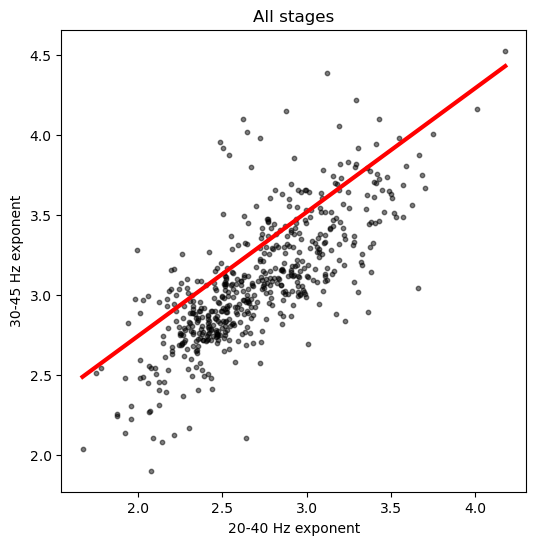

Linregress LinregressResult(slope=0.6540698938143181, intercept=1.3424414313015238, rvalue=0.6218982559231166, pvalue=1.1965435291636555e-20, stderr=0.0617320875088648, intercept_stderr=0.1886208691976407)
Spearman SignificanceResult(statistic=0.6052264987602498, pvalue=2.2794322494189838e-19)


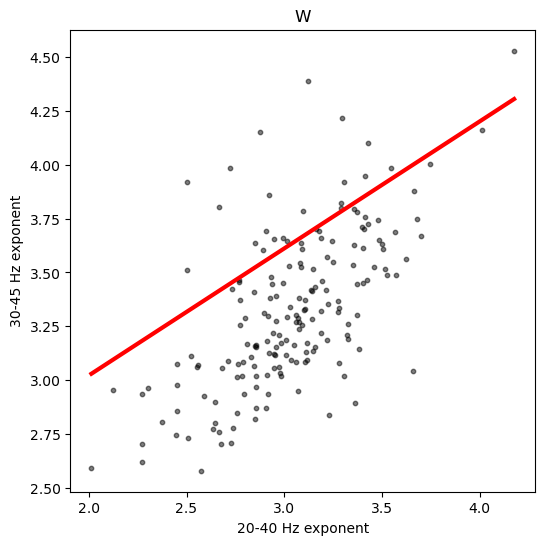

Linregress LinregressResult(slope=0.9155752064320501, intercept=0.568958153927233, rvalue=0.7505064344628928, pvalue=7.5642661614555095e-34, stderr=0.06042840523404328, intercept_stderr=0.14759110386876859)
Spearman SignificanceResult(statistic=0.7252610677284278, pvalue=1.1414457636817643e-30)


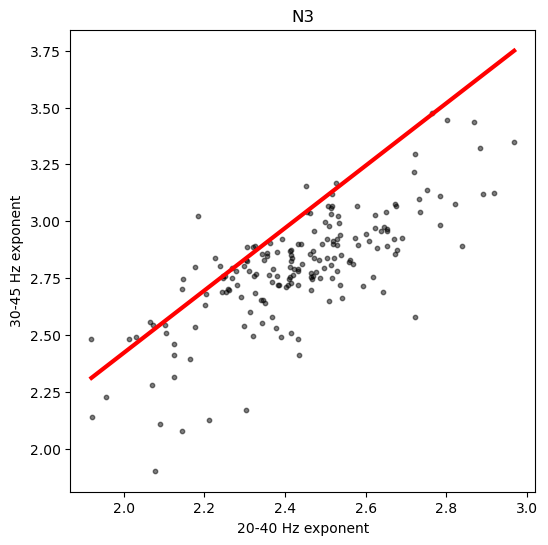

Linregress LinregressResult(slope=0.6348711238840651, intercept=1.4424130110681068, rvalue=0.6329471309320697, pvalue=1.536670021862439e-21, stderr=0.05820476111360502, intercept_stderr=0.15394312432858032)
Spearman SignificanceResult(statistic=0.6263073963188164, pvalue=5.3271644120489e-21)


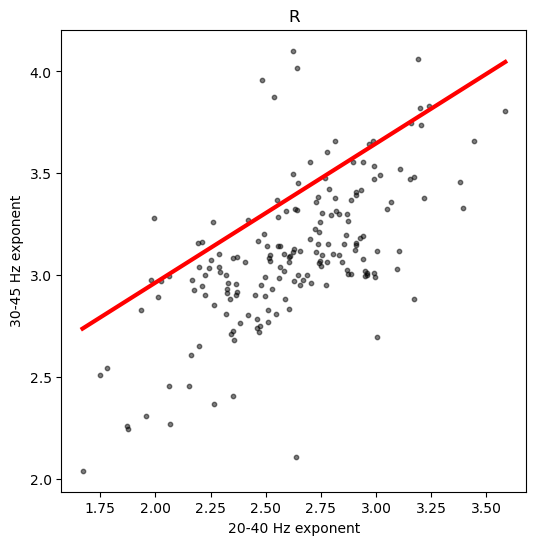

In [13]:
# All stages
x = df_exp_20_40_parc_all.to_numpy().squeeze()
y = df_exp_30_45_parc_all.to_numpy().squeeze()
res = linregress(x, y)
print("Linregress", res)
print("Spearman", spearmanr(x, y))

plt.figure(figsize=(6, 6))
plt.scatter(x, y, c="k", alpha=0.5, s=10)
plt.plot(
    [x.min(), x.max()],
    [
        res.intercept + res.slope * y.min(),
        res.intercept + res.slope * y.max(),
    ],
    "r",
    linewidth=3,
)
# plt.ylim(0, 200)
plt.xlabel("20-40 Hz exponent")
plt.ylabel("30-45 Hz exponent")
plt.title("All stages")
plt.show()

# Separately for sleep stages
for stage in ["W", "N3", "R"]:
    x = df_exp_20_40_parc[stage].to_numpy().squeeze()
    y = df_exp_30_45_parc[stage].to_numpy().squeeze()
    res = linregress(x, y)
    print("Linregress", res)
    print("Spearman", spearmanr(x, y))

    plt.figure(figsize=(6, 6))
    plt.scatter(x, y, c="k", alpha=0.5, s=10)
    plt.plot(
        [x.min(), x.max()],
        [
            res.intercept + res.slope * y.min(),
            res.intercept + res.slope * y.max(),
        ],
        "r",
        linewidth=3,
    )
    # plt.ylim(0, 200)
    plt.xlabel("20-40 Hz exponent")
    plt.ylabel("30-45 Hz exponent")
    plt.title(stage)
    plt.show()

## Average over MNI atlas regions

In [48]:
df_tau = pd.read_csv(res_path.joinpath("all_tau.csv"), index_col=0)
df_tau = df_tau.dropna()
df_tau_avg = df_tau[df_tau["stage"] == "W"]
# df_tau_avg_med_med = df_tau_avg[["pat", "region", "tau"]].groupby(["pat", "region"]).median().groupby("region").median().sort_values("tau")
df_tau_avg_med = (
    df_tau_avg[["region", "tau"]].groupby(["region"]).mean().sort_values("tau")
)
df_tau_avg_med

,tau
region,
Medial segment of precentral gyrus,15.157597
Precentral gyrus,15.184623
Opercular part of inferior frontal gyrus,17.738942
Middle frontal gyrus,18.448598
Postcentral gyrus (including medial segment),18.637501
Supplementary motor cortex,18.976305
Middle cingulate,19.784592
Planum temporale,19.922996
Medial segment of superior frontal gyrus,20.011839


In [33]:
data = df_tau[df_tau["stage"] == "W"].copy()
md = smf.mixedlm("tau ~ 0 + region", data, groups=data["pat"])
mdf = md.fit()
print(mdf.summary())


                             Mixed Linear Model Regression Results
Model:                         MixedLM              Dependent Variable:              tau       
No. Observations:              1772                 Method:                          REML      
No. Groups:                    106                  Scale:                           127.1777  
Min. group size:               1                    Log-Likelihood:                  -6826.1070
Max. group size:               59                   Converged:                       Yes       
Mean group size:               16.7                                                            
-----------------------------------------------------------------------------------------------
                                                     Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------------------------------------
region[Amygdala]                                     45.251    5.359 

In [40]:
df_tau_avg_mem = mdf.fe_params
df_tau_avg_mem.index = df_tau_avg_mem.index.str.strip("region[").str.strip("]")
df_tau_avg_mem = df_tau_avg_mem.sort_values()
df_tau_avg_mem


Medial segment of precentral gyrus              11.906409
Cuneus                                          17.044389
Postcentral gyrus (including medial segment)    19.813758
Calcarine cortex                                20.040284
Precentral gyrus                                20.049066
Superior parietal lobule                        21.145536
Opercular part of inferior frontal gyrus        21.816255
Lingual gyrus and occipital fusiform gyrus      23.624658
Supramarginal gyrus                             24.097596
Superior and middle occipital gyri              24.272289
Precuneus                                       24.492385
Middle frontal gyrus                            24.748185
Orbital part of inferior frontal gyrus          25.045021
Superior frontal gyrus and frontal pole         25.652324
Inferior temporal gyrus                         26.133999
Supplementary motor cortex                      26.209330
Triangular part of inferior frontal gyrus       26.276189
Central opercu

## Spatial correlations

In [5]:
from scipy import signal
from scipy.io import loadmat
from pathlib import Path


In [2]:
for mode in ["full", "valid", "same"]:
    print(signal.correlation_lags(1024, 1024, mode=mode))

[-1023 -1022 -1021 ...  1021  1022  1023]
[0]
[-512 -511 -510 ...  509  510  511]


In [6]:
base_path = Path("D:\\iEEG_neural_dynamics\\MNIOpen")

###
# Import data
###

data_path = base_path.joinpath("MatlabFile.mat")
data = loadmat(data_path)
data_W = data["Data_W"].T
data_N2 = data["Data_N2"].T
data_N3 = data["Data_N3"].T
data_R = data["Data_R"].T

###
# Convert data to Dataframe
###

ch_names = data["ChannelName"].squeeze()
ch_types = data["ChannelType"].squeeze()
ch_regs = data["ChannelRegion"].squeeze()
pat_ids = data["Patient"].squeeze()
gender = data["Gender"].squeeze()
age = data["AgeAtTimeOfStudy"].squeeze()
ch_pos = data["ChannelPosition"].squeeze()
regions_map = {i + 1: r[0][0] for i, r in enumerate(data["RegionName"])}
sfreq = data["SamplingFrequency"][0][0]


In [13]:
np.where(pat_ids == 1)[0]


array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13],
      dtype=int64)

In [15]:
data_test = data_W[pat_ids == 1]
data_test.shape


(14, 13600)

In [52]:
ch1, ch2 = data_test[0, : sfreq * 2], data_test[-1, : sfreq * 2]

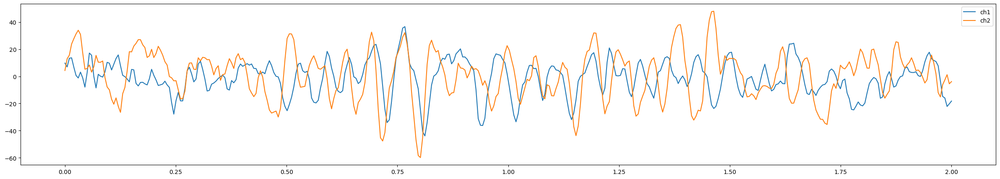

In [53]:
plt.figure(figsize=(30, 5))
t = np.linspace(0, 2, 2 * sfreq)
plt.plot(t, ch1, label="ch1")
plt.plot(t, ch2, label="ch2")
plt.legend()
plt.show()


In [54]:
ch1_norm = ch1 / np.linalg.norm(ch1)  # (ch1 - ch1.mean()) / (ch1.std() * len(ch1))
ch2_norm = ch2 / np.linalg.norm(ch2)  # (ch2 - ch2.mean()) / ch2.std()
corr = signal.correlate(ch1_norm, ch2_norm, mode="same")
lags = signal.correlation_lags(len(ch1_norm), len(ch2_norm), mode="same")

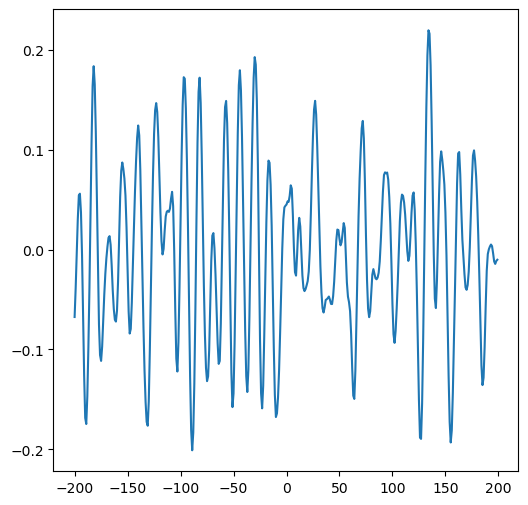

In [55]:
plt.figure(figsize=[6, 6])
plt.plot(lags, corr)
# plt.xlim(-50,50)
plt.show()

In [56]:
lags[np.argmax(corr)]


134

### Plot some PSD / ACF comparisons

In [17]:
df_tau = pd.read_csv(base_path.joinpath("Results/all_tau.csv"), index_col=0)
df_exp = pd.read_csv(base_path.joinpath("Results/all_knee.csv"), index_col=0)
df_tau, df_exp = df_tau.dropna(), df_exp.dropna()
df_regions_mni = pd.read_csv(base_path.joinpath("RegionInformation.csv"))
df_regions_mni["Region name"] = df_regions_mni["Region name"].apply(
    lambda x: x.strip("'")
)

df_tau["lobe"] = (
    df_regions_mni.set_index("Region name").loc[df_tau["region"]]["Lobe"].values
)
df_exp["lobe"] = (
    df_regions_mni.set_index("Region name").loc[df_exp["region"]]["Lobe"].values
)

In [28]:
pats_all_stages = [
    pat
    for pat, count in zip(
        *np.unique(
            df_tau.groupby(["pat", "stage"]).count().index.get_level_values(0),
            return_counts=True,
        )
    )
    if count == 4
]

Pat 9


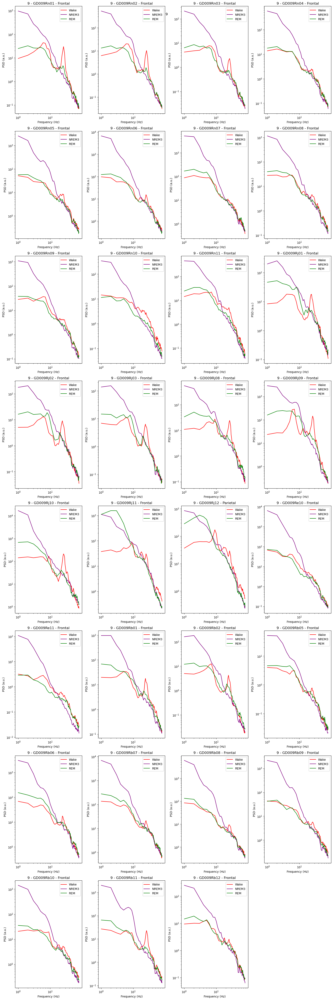

Pat 10


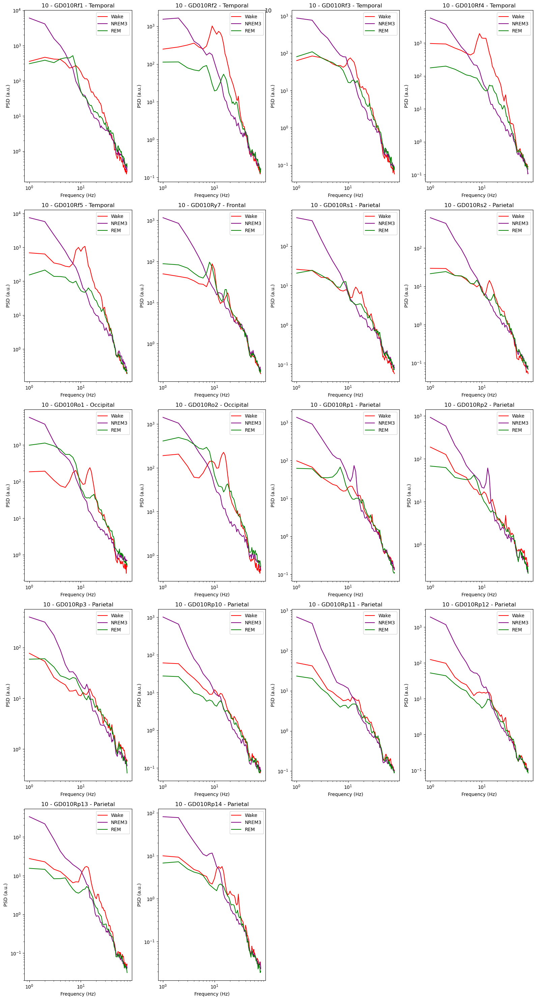

Pat 12


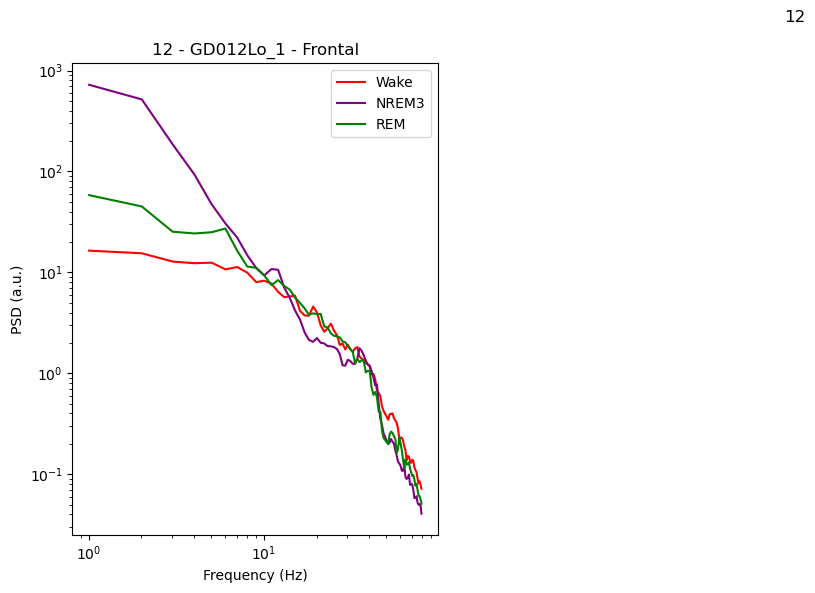

Pat 16


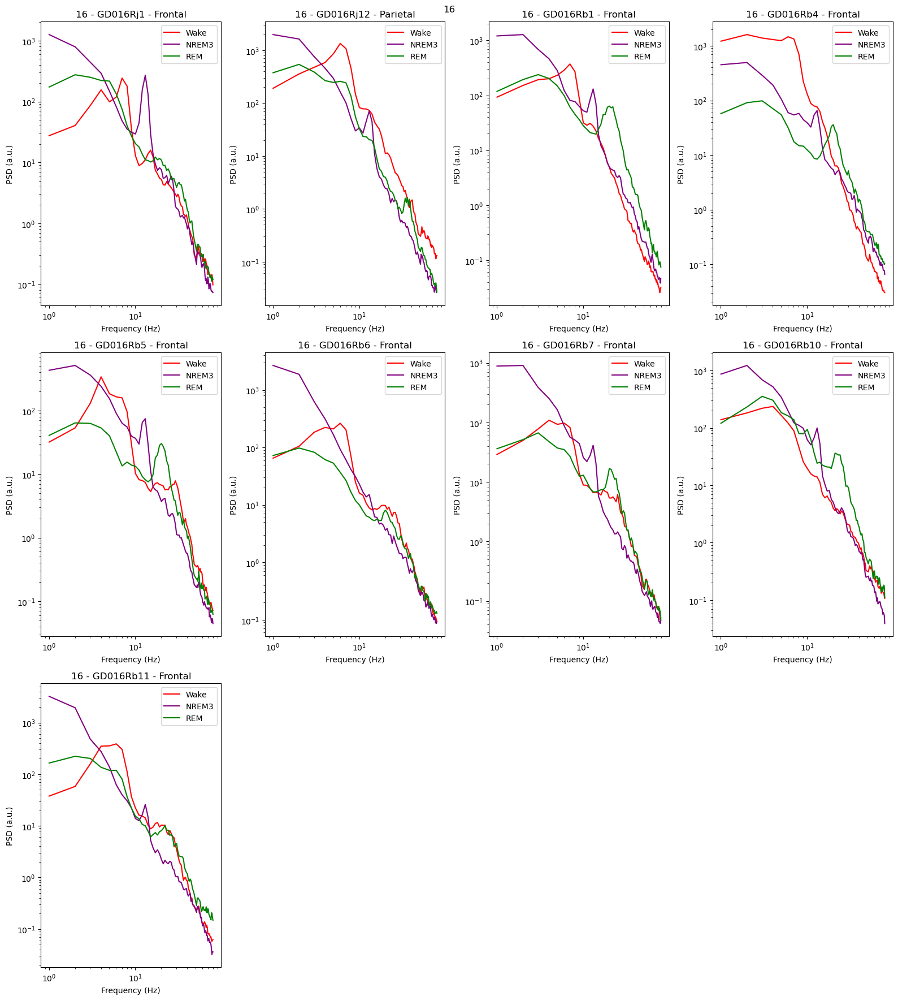

Pat 17


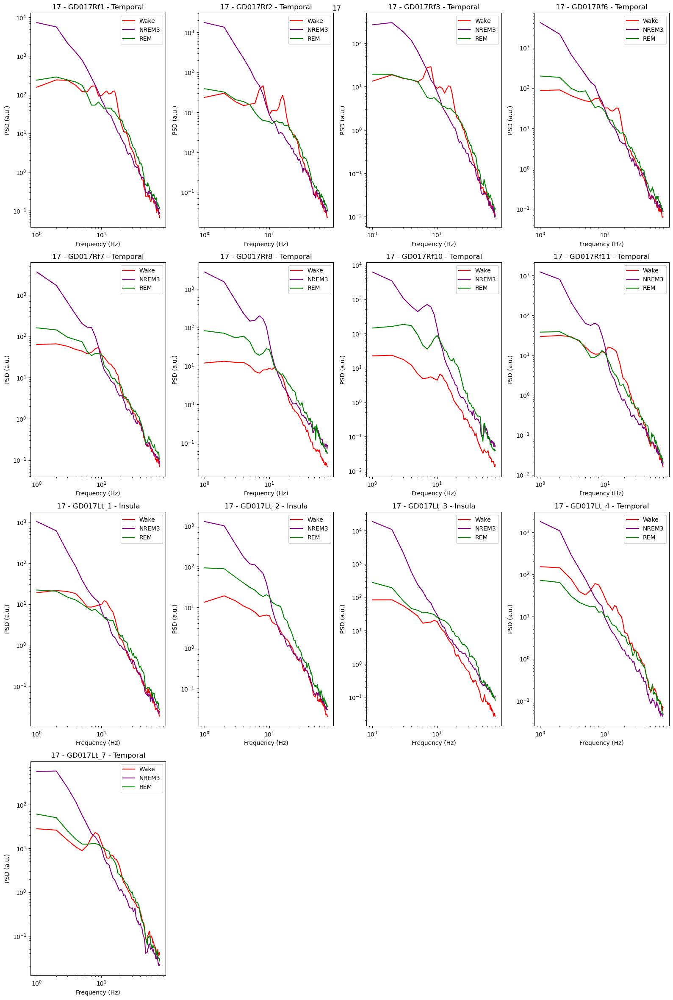

Pat 18


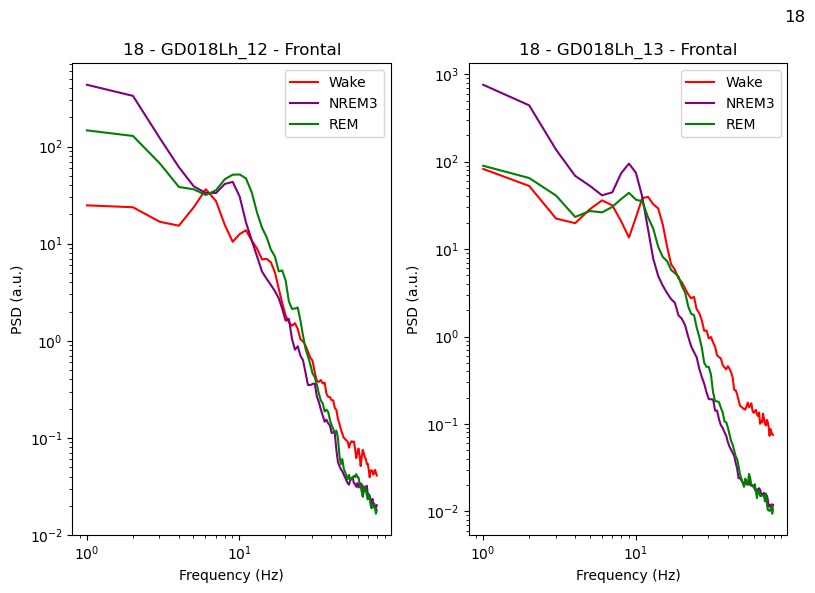

Pat 20


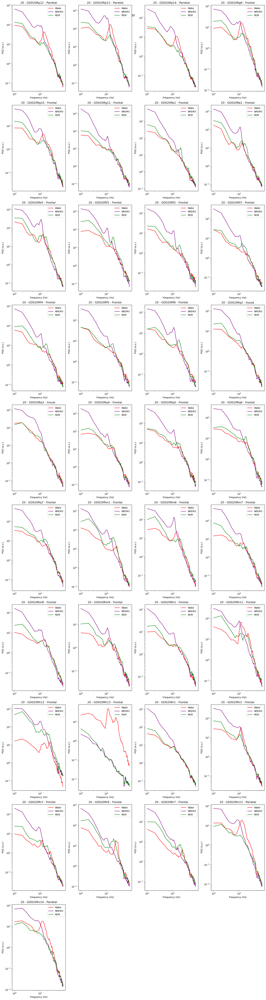

Pat 21


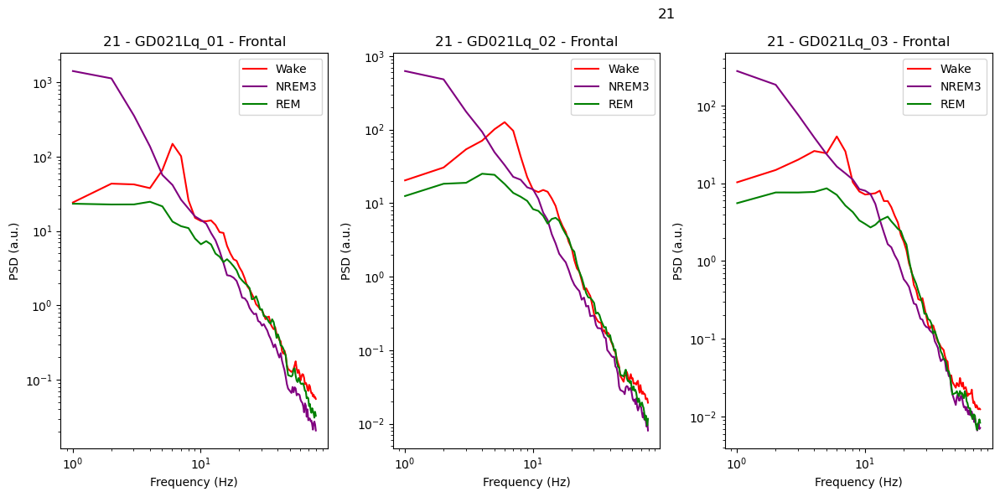

Pat 22


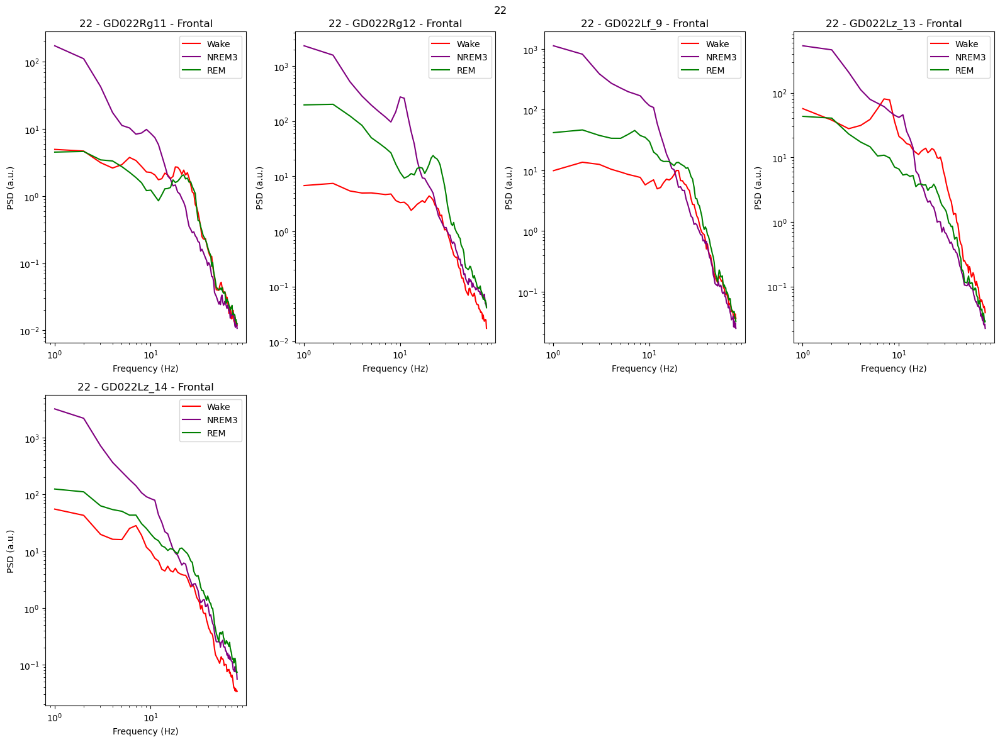

Pat 24


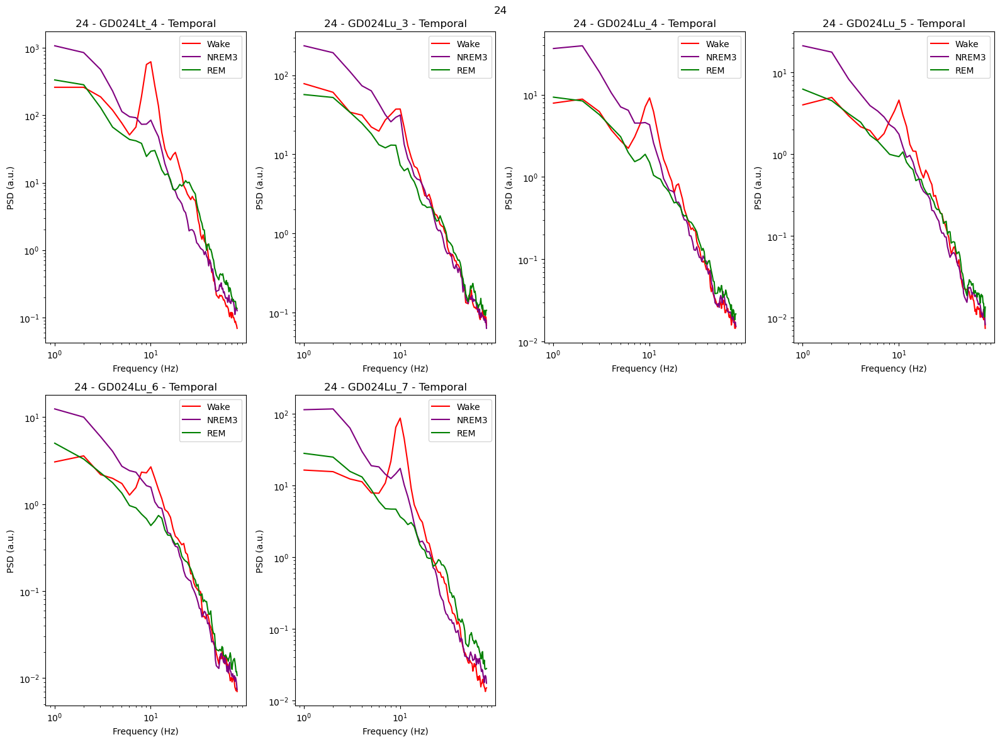

Pat 26


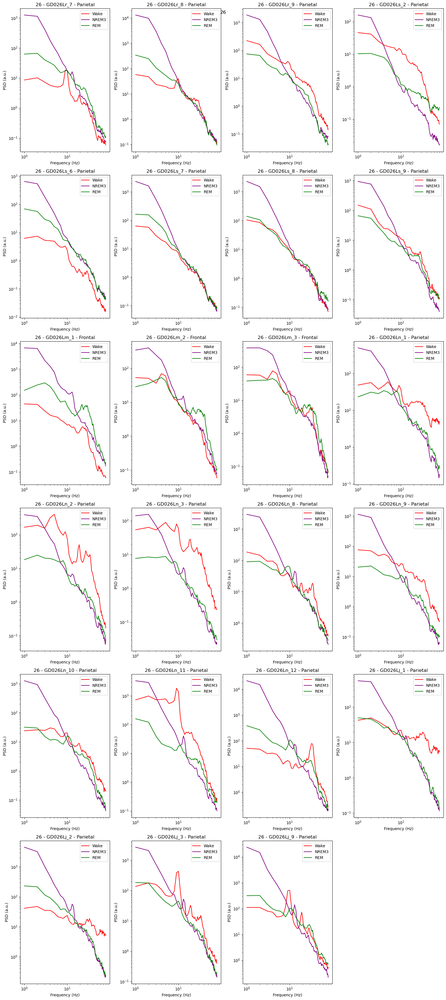

Pat 28


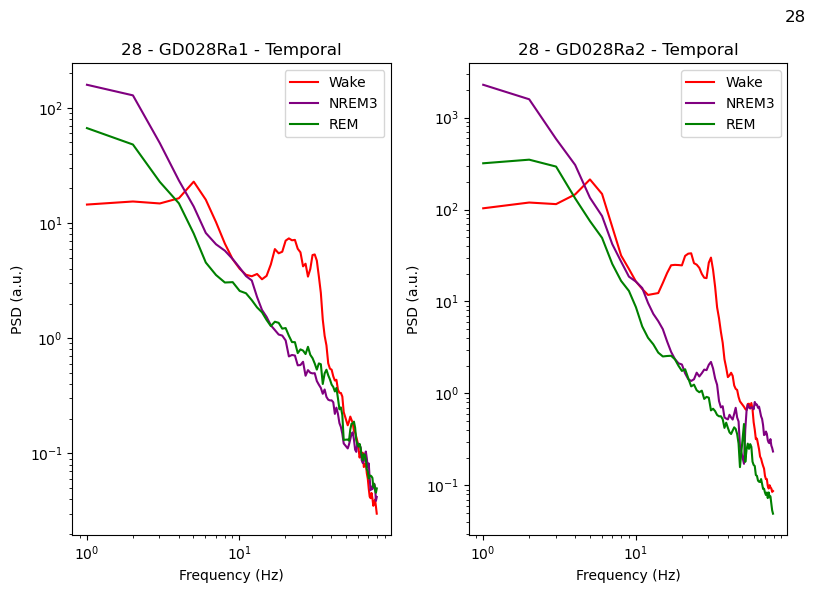

Pat 33


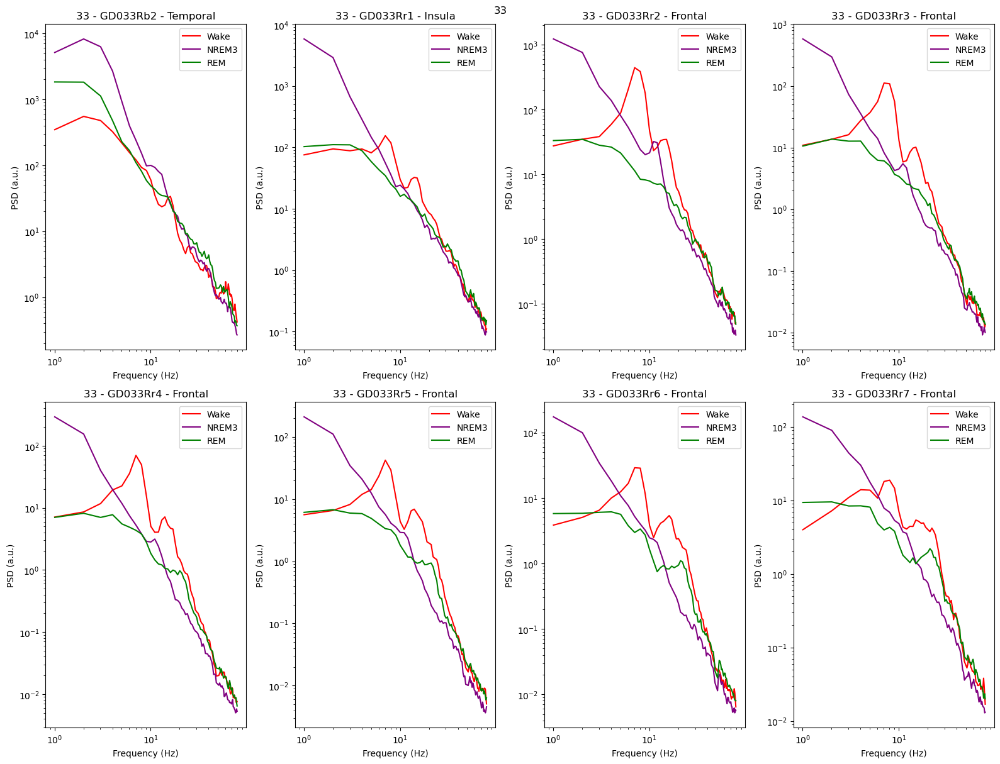

Pat 34


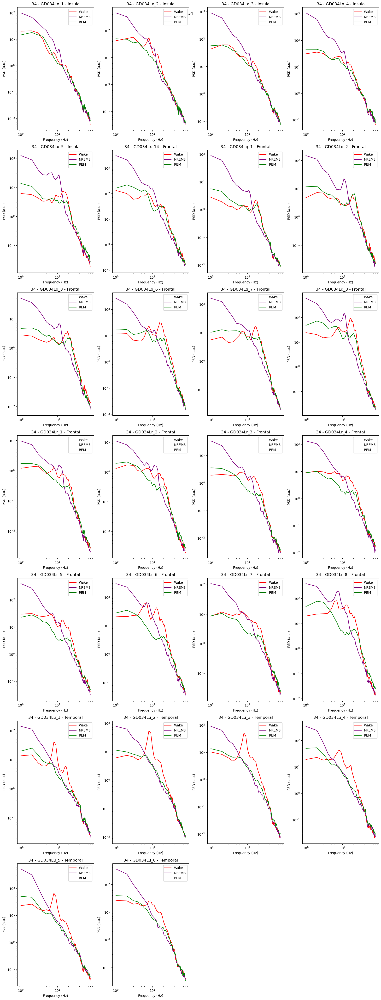

Pat 37


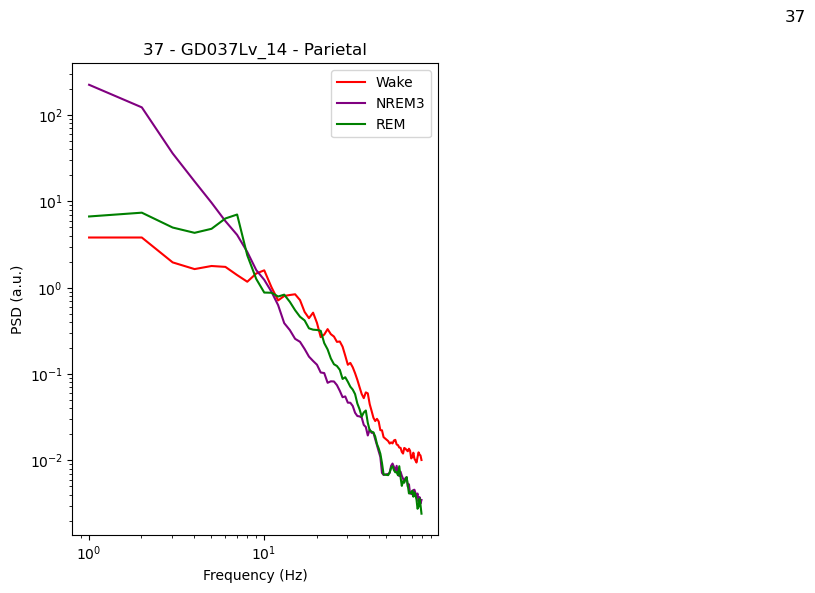

Pat 41


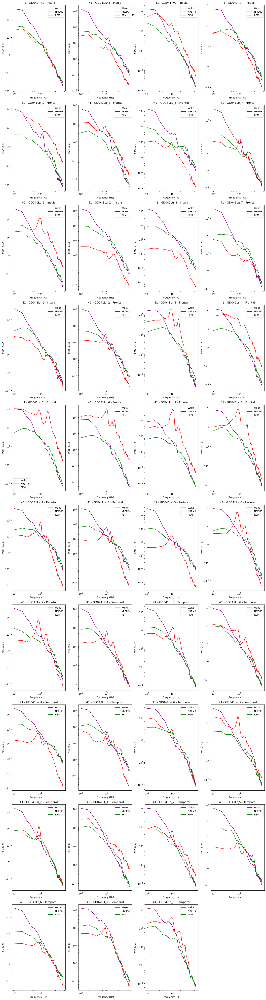

Pat 42


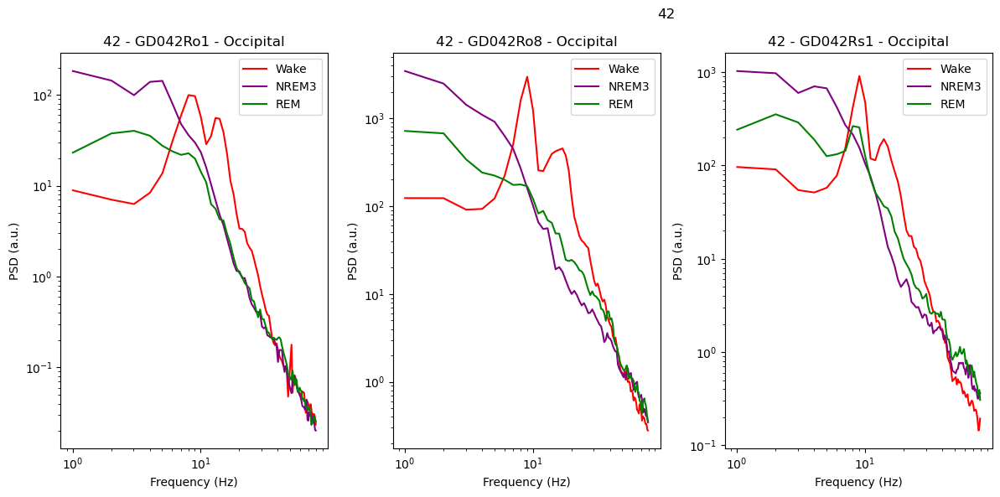

Pat 43


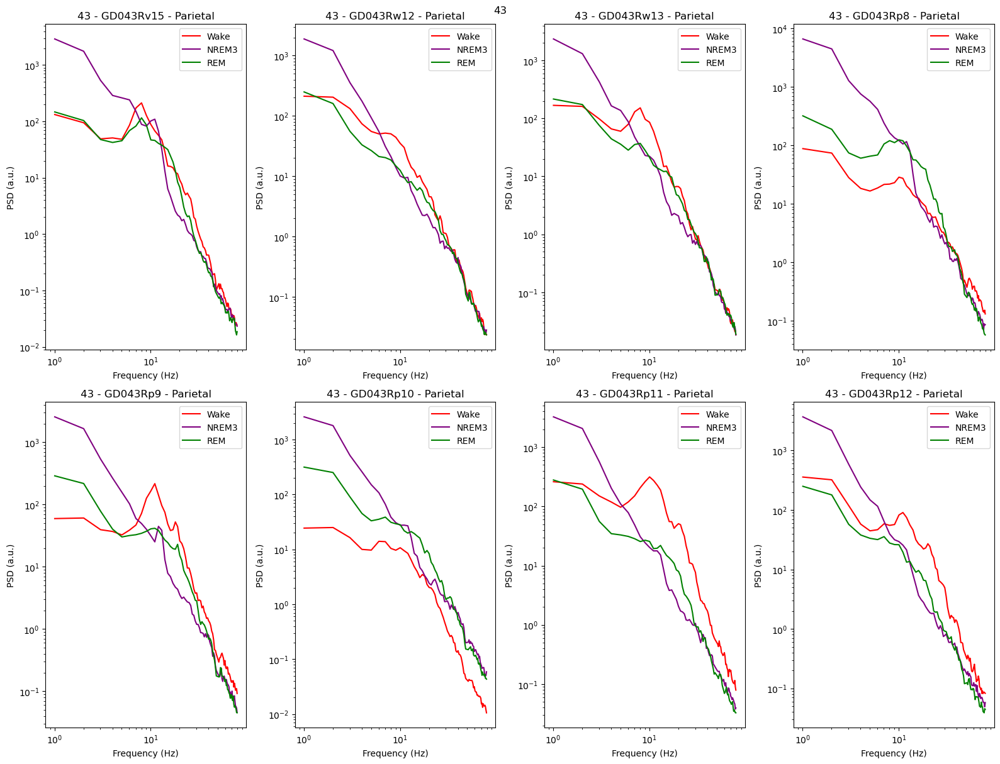

Pat 44


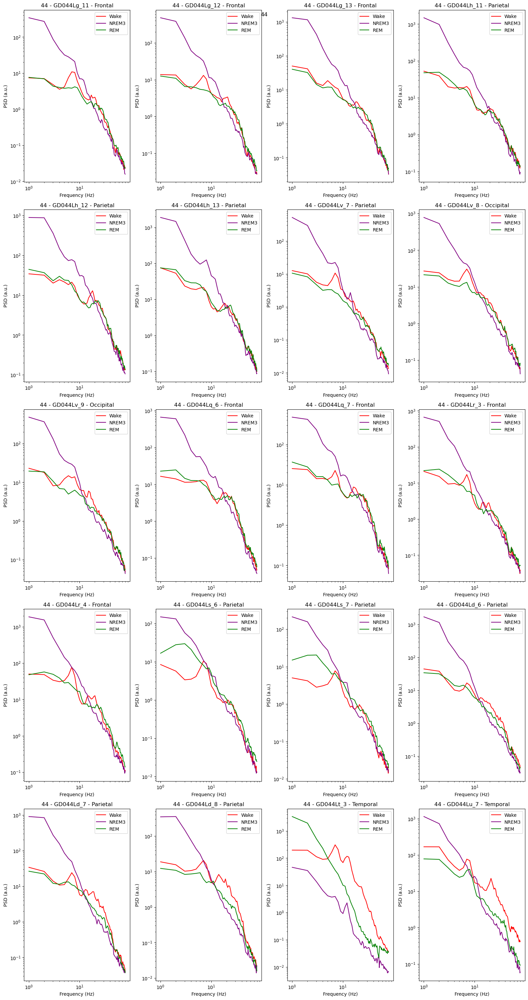

Pat 47


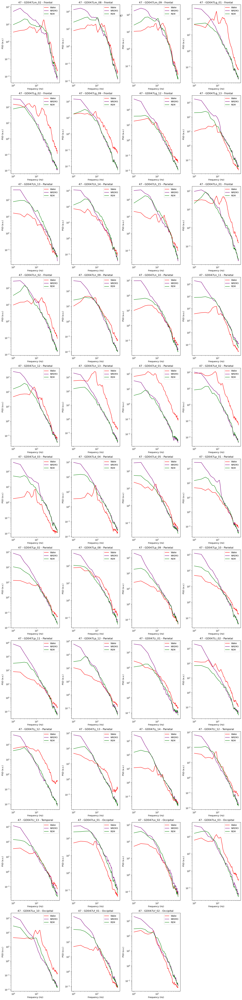

Pat 48


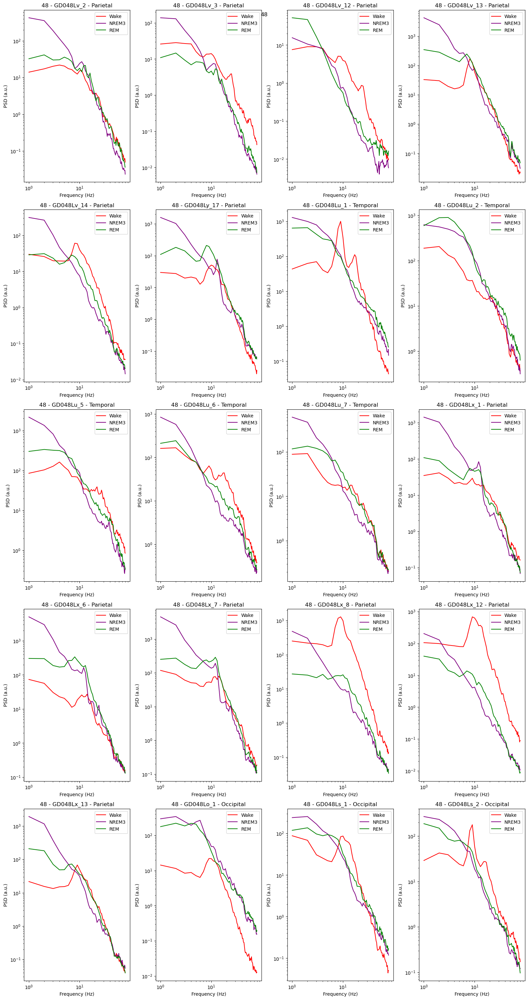

Pat 49


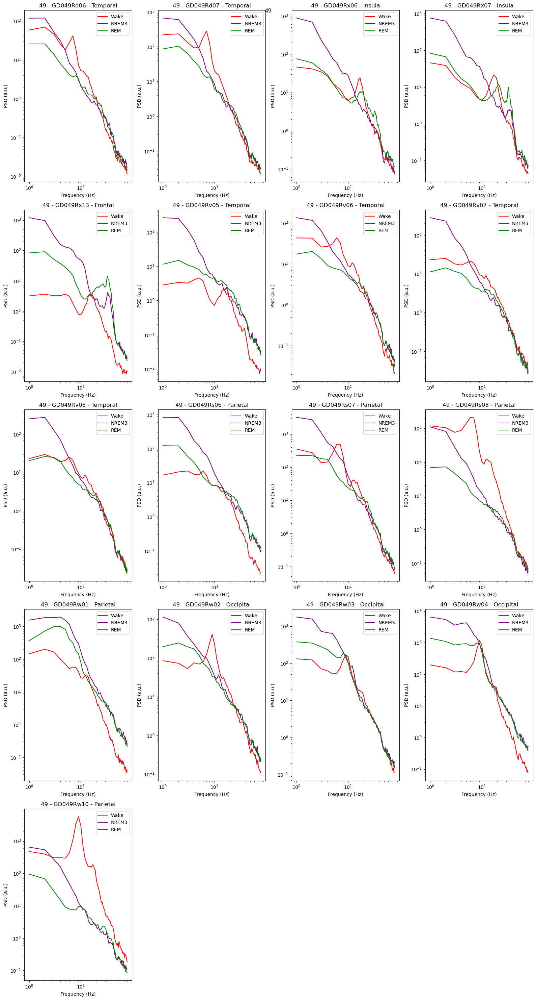

Pat 52


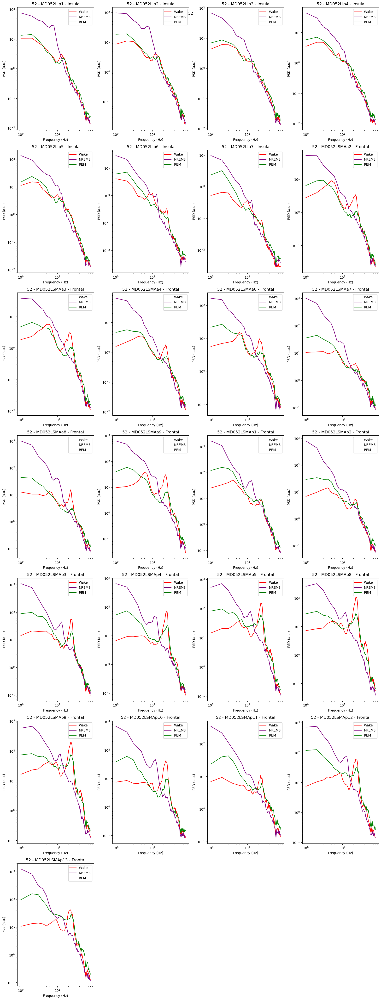

Pat 53


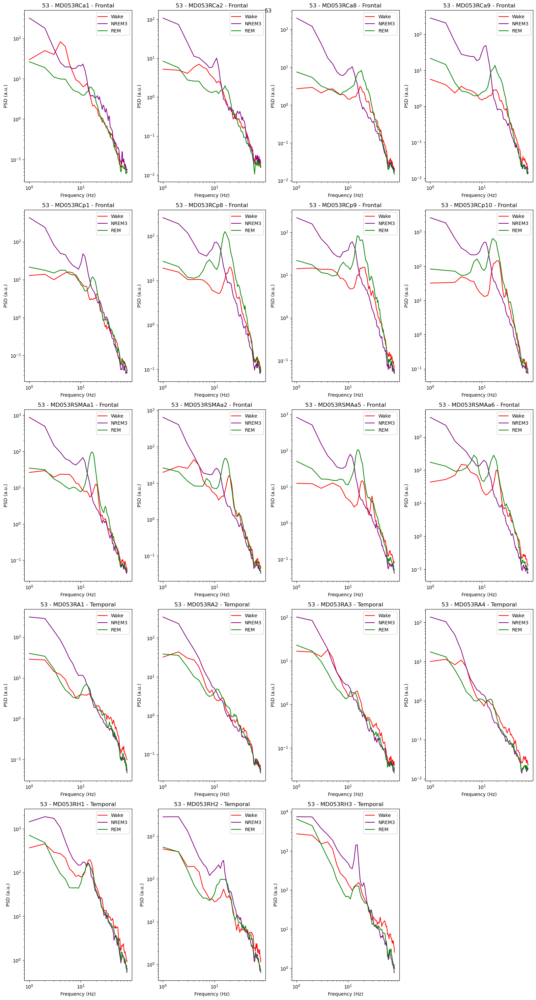

Pat 54


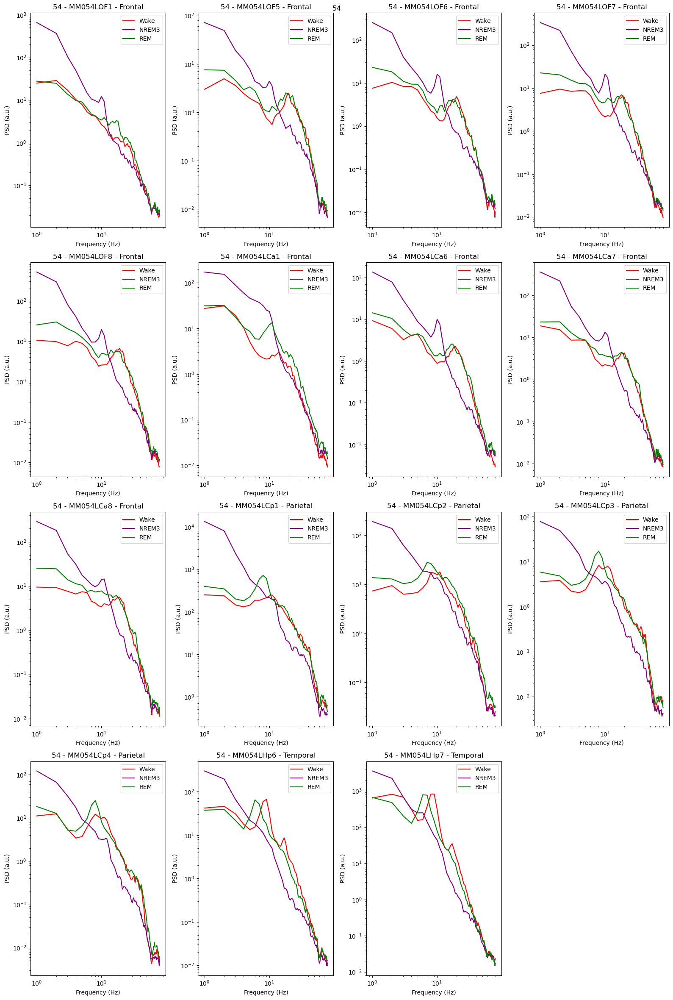

Pat 55


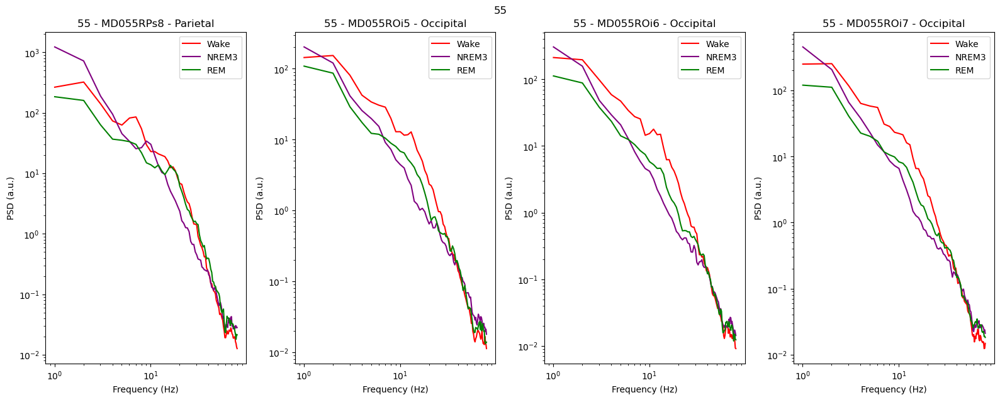

Pat 58


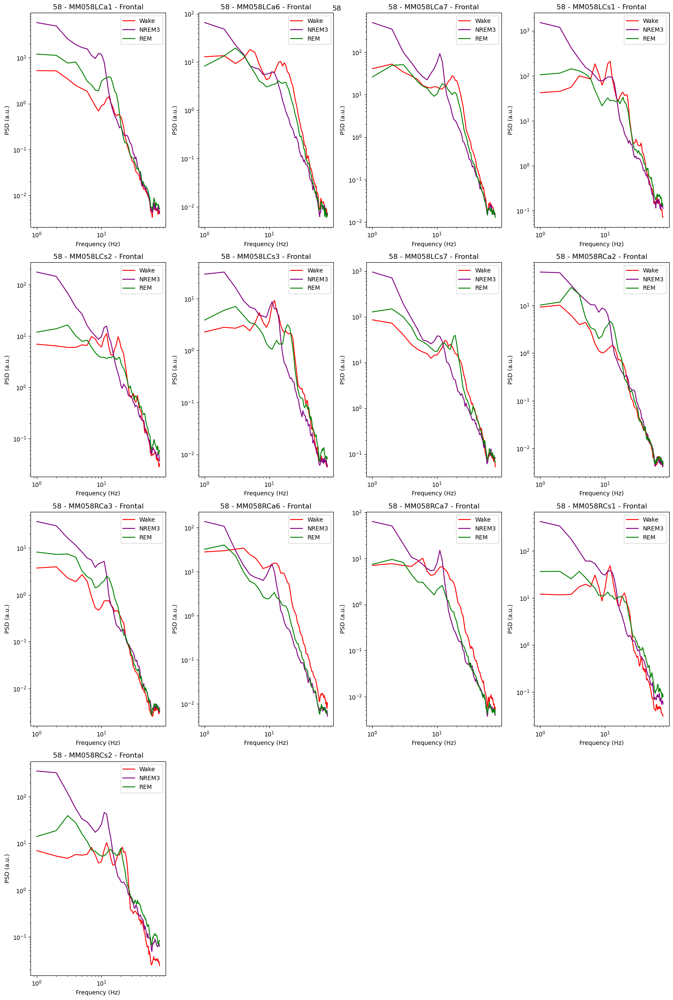

Pat 59


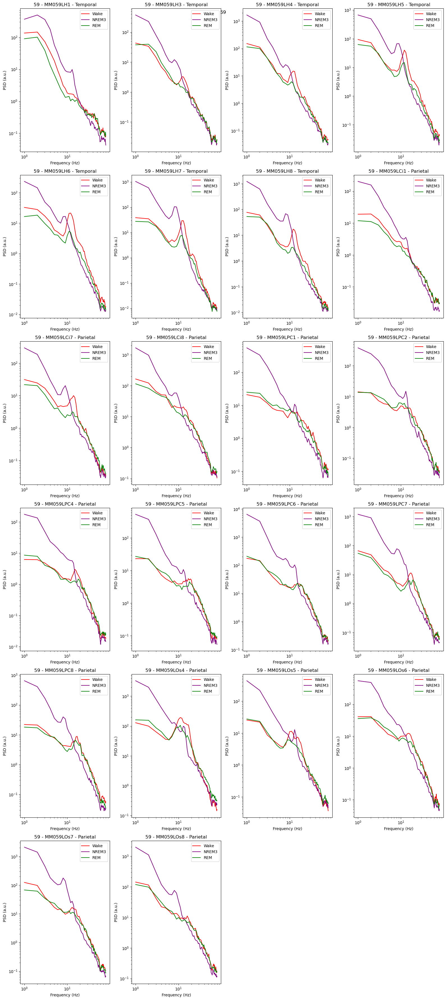

Pat 60


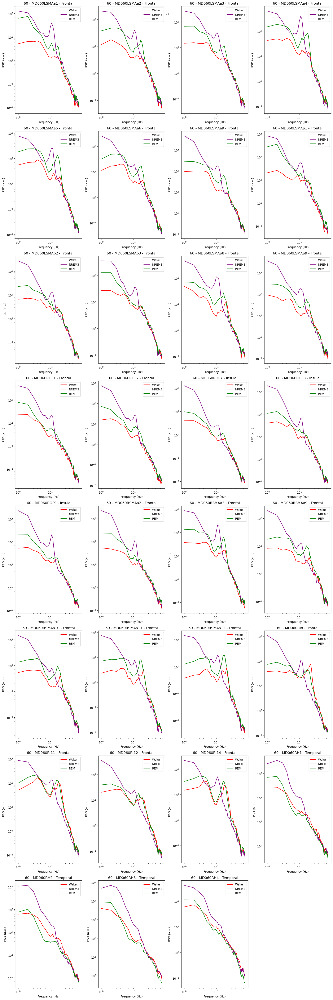

Pat 61


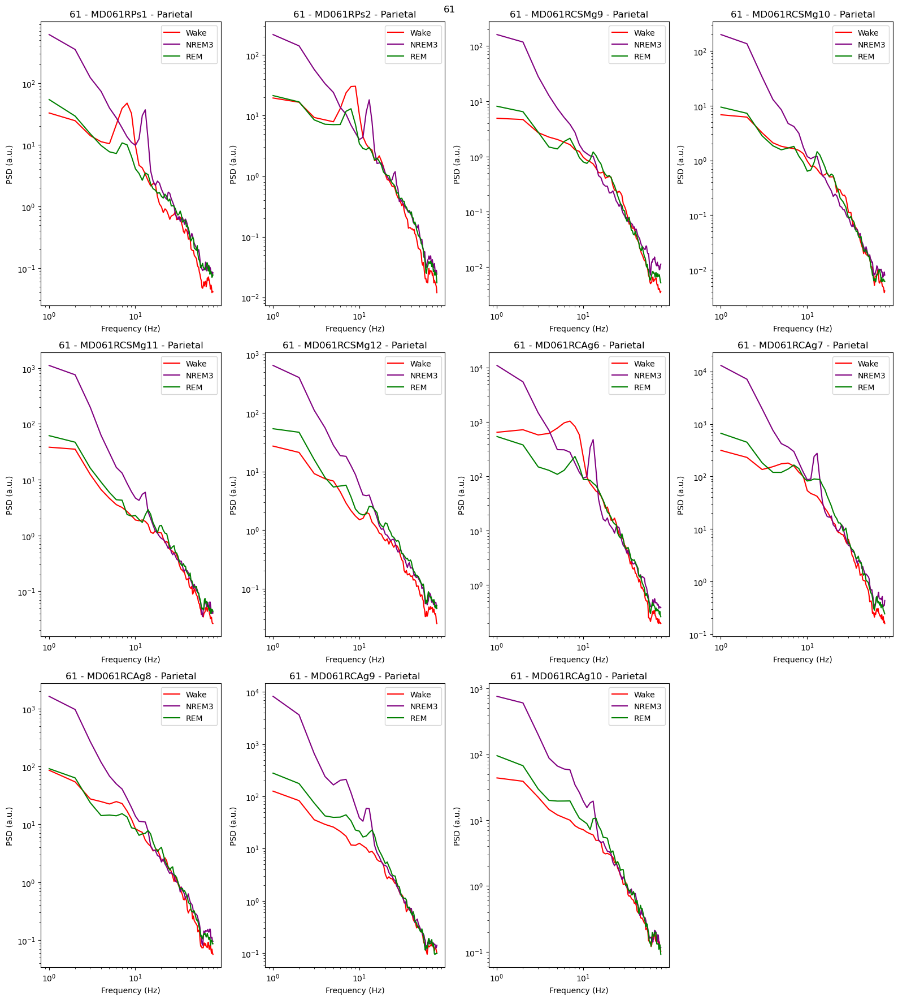

Pat 62


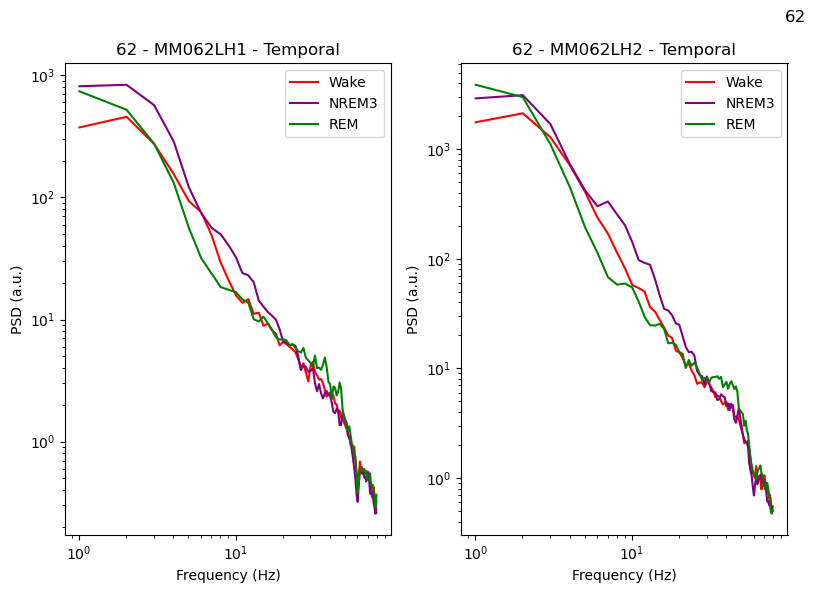

Pat 63


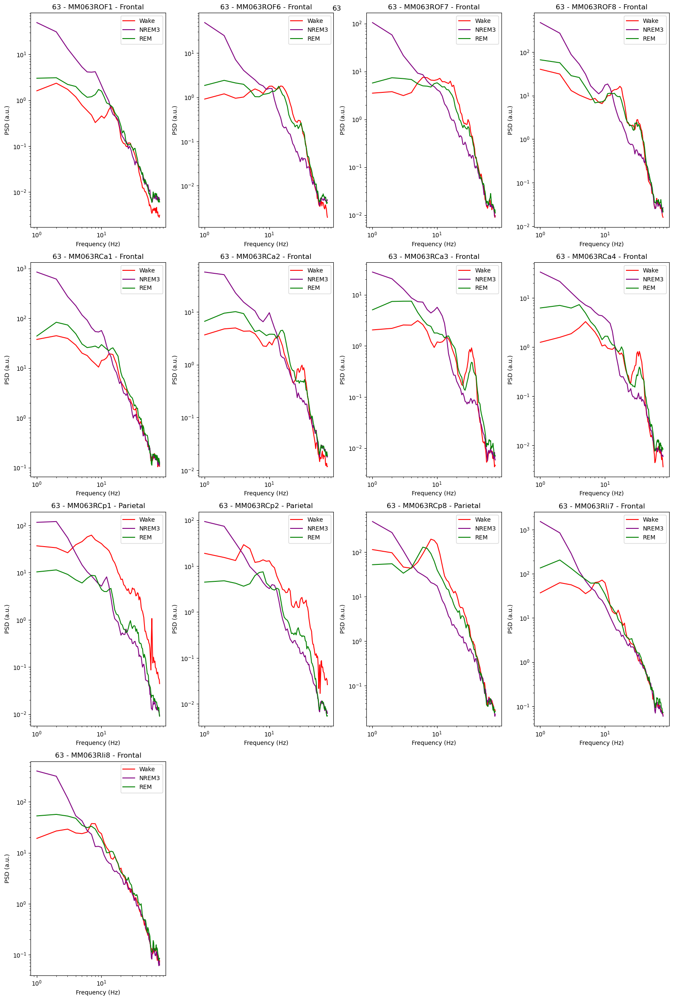

Pat 65


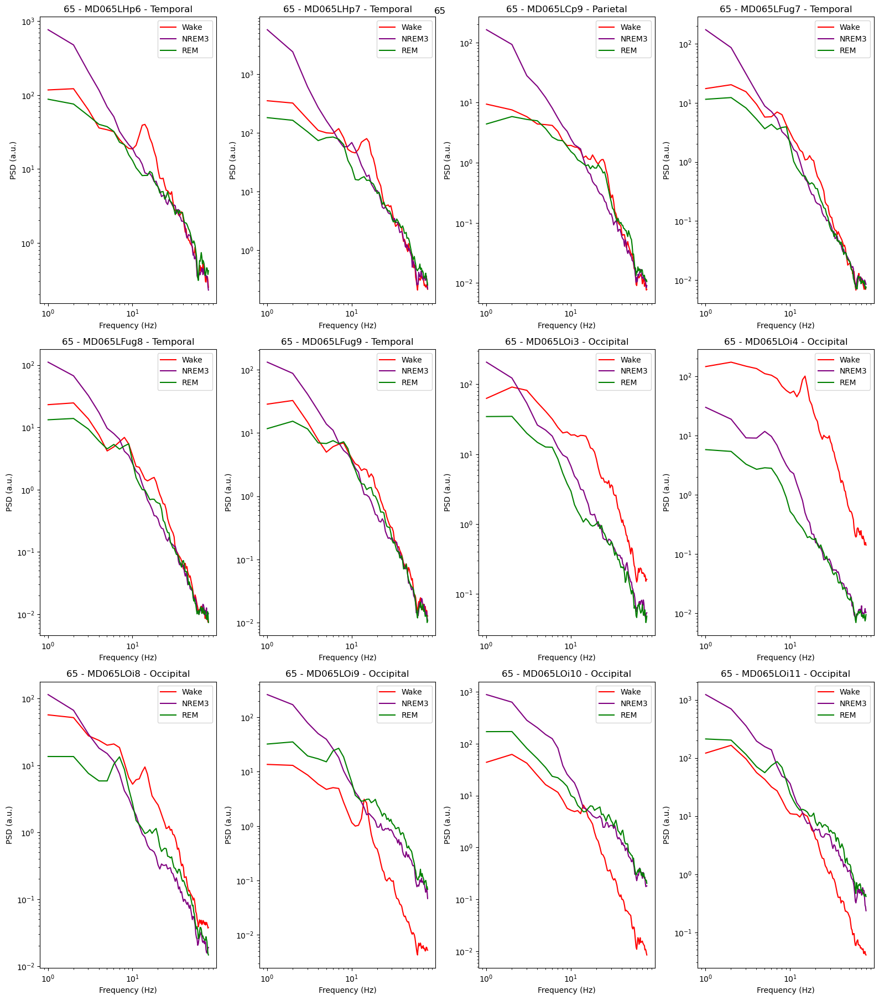

Pat 66


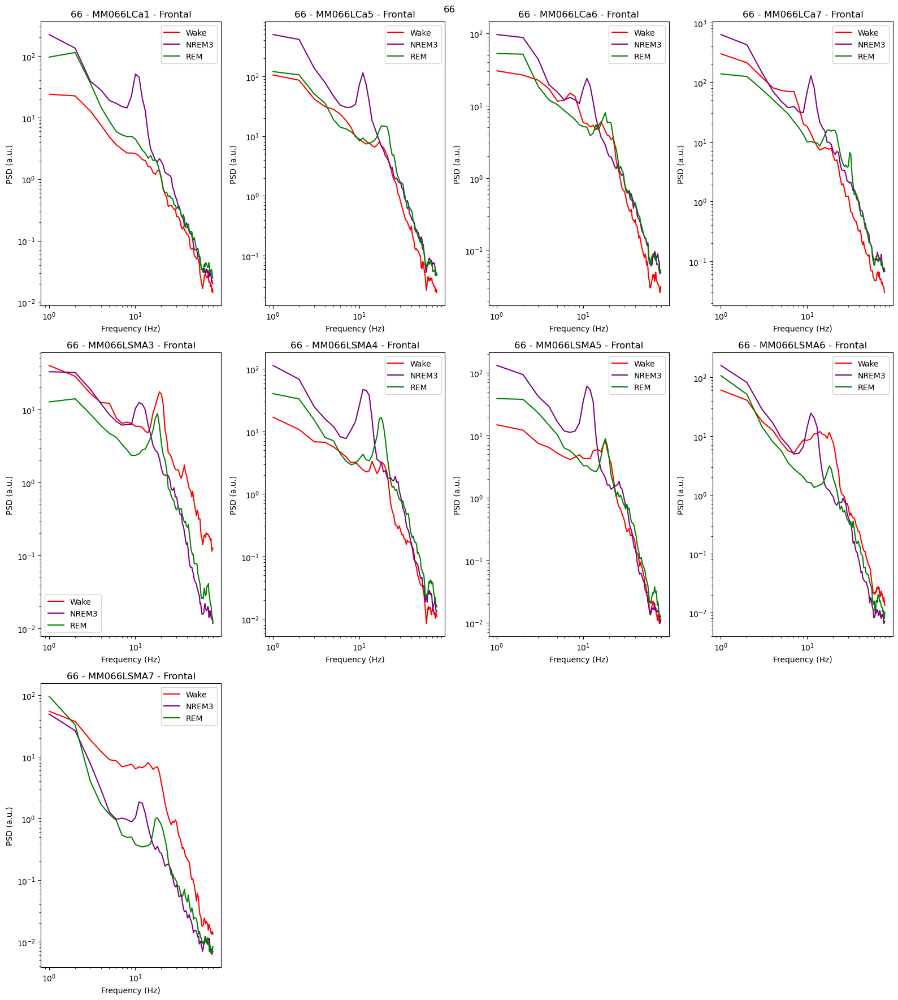

Pat 67


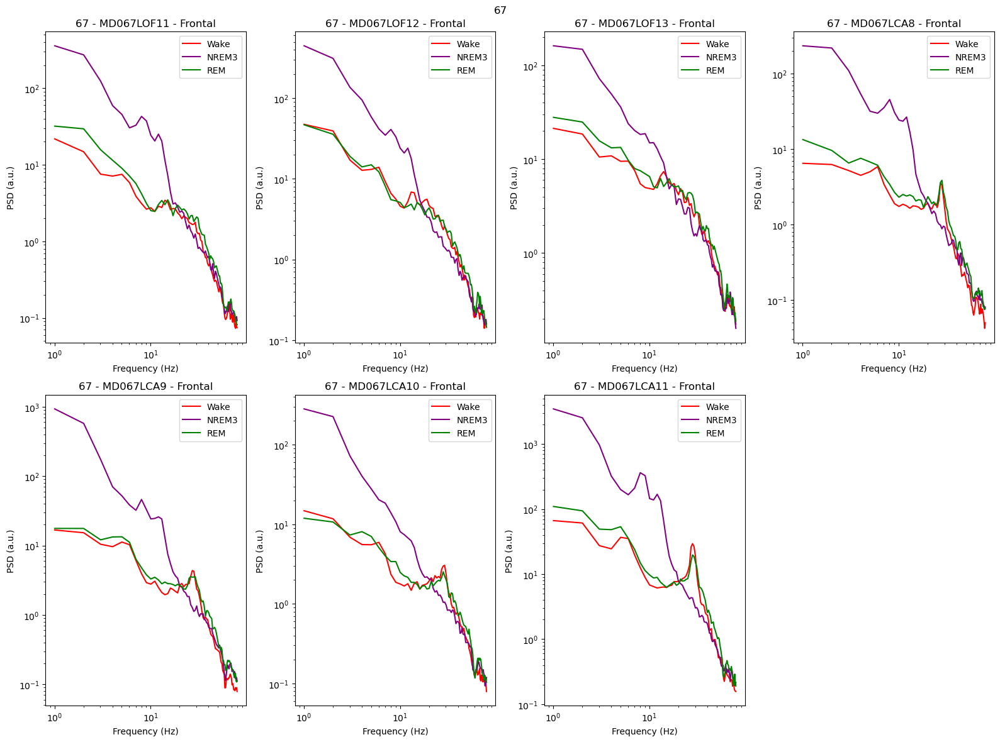

Pat 68


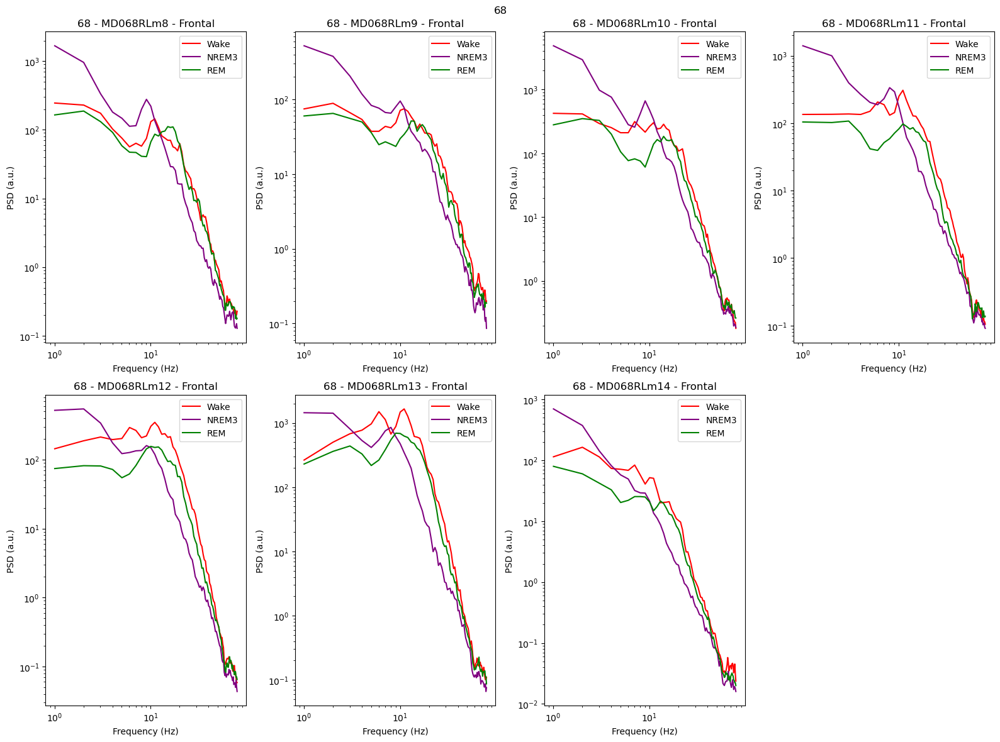

Pat 69


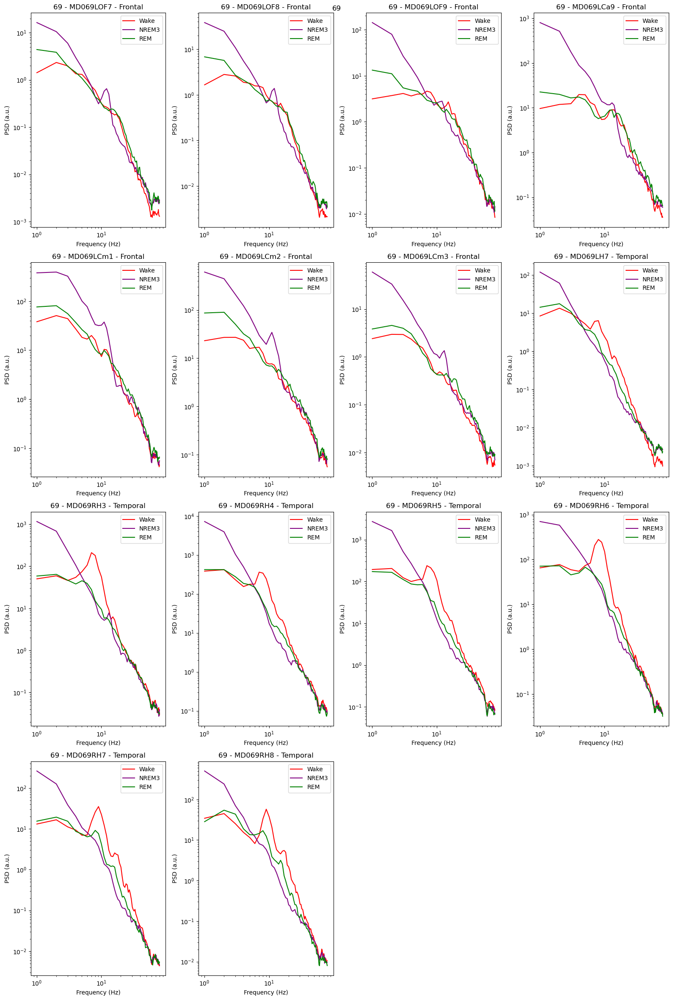

Pat 70


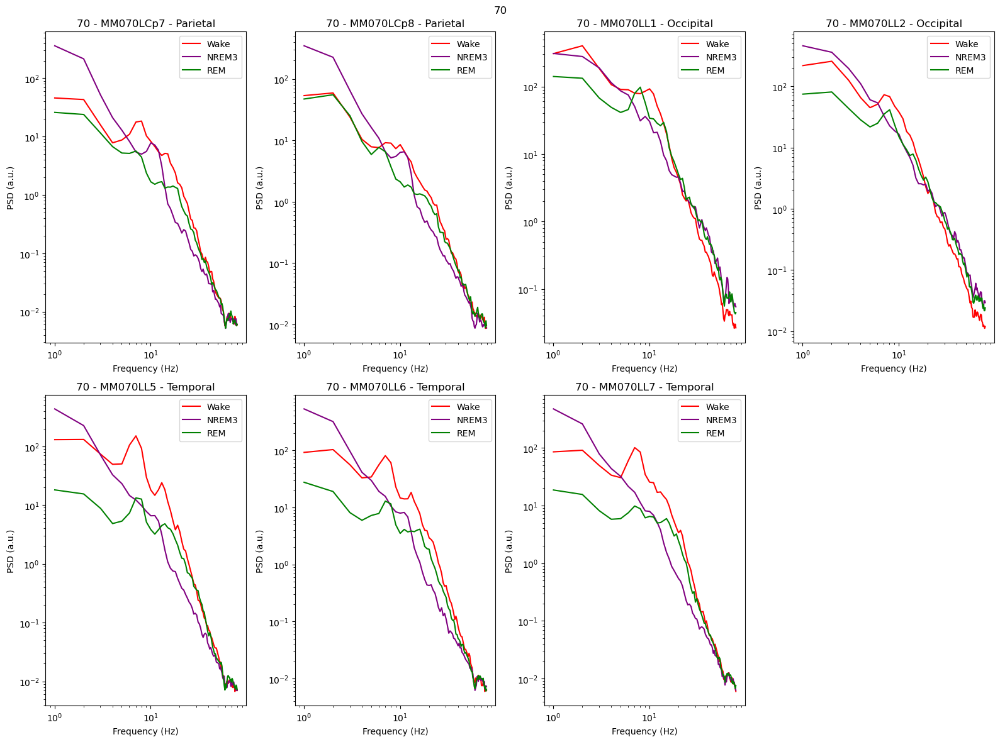

Pat 71


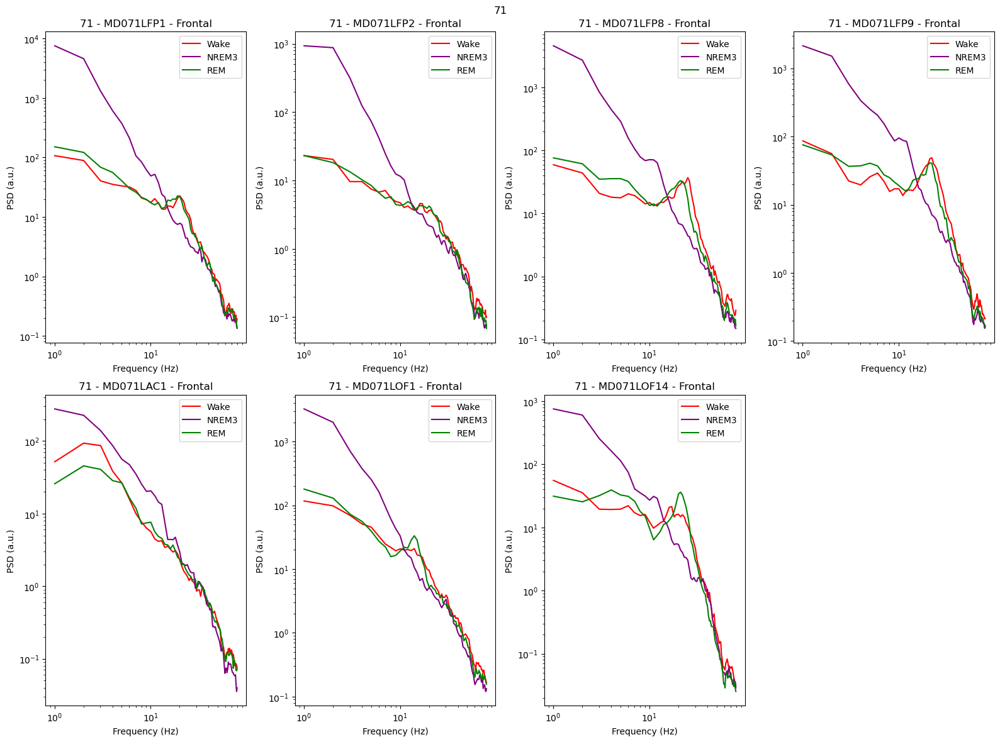

Pat 72


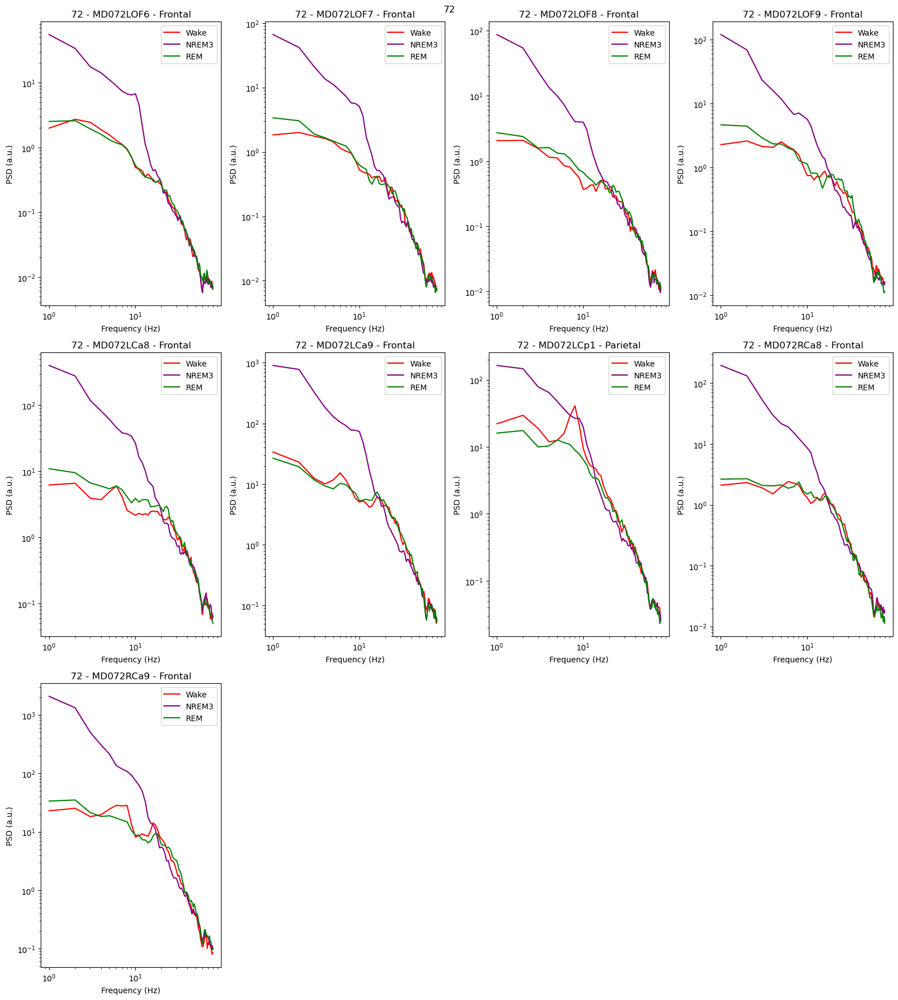

Pat 73


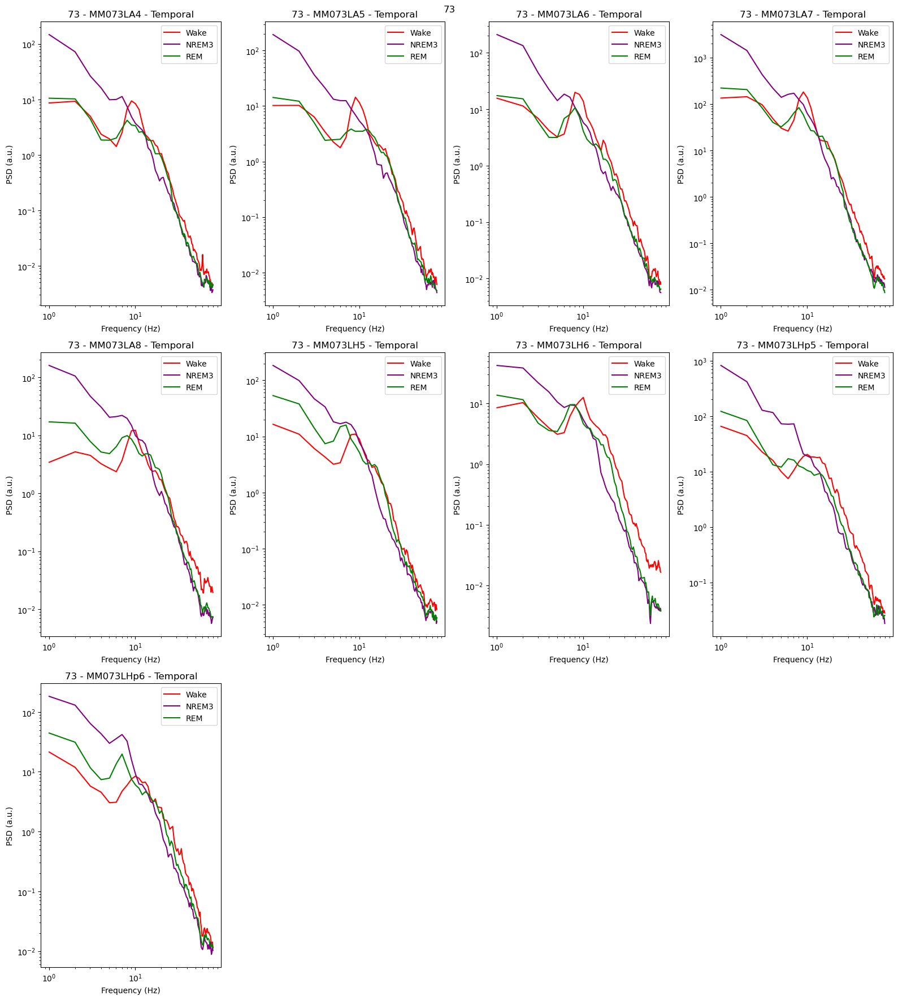

Pat 74


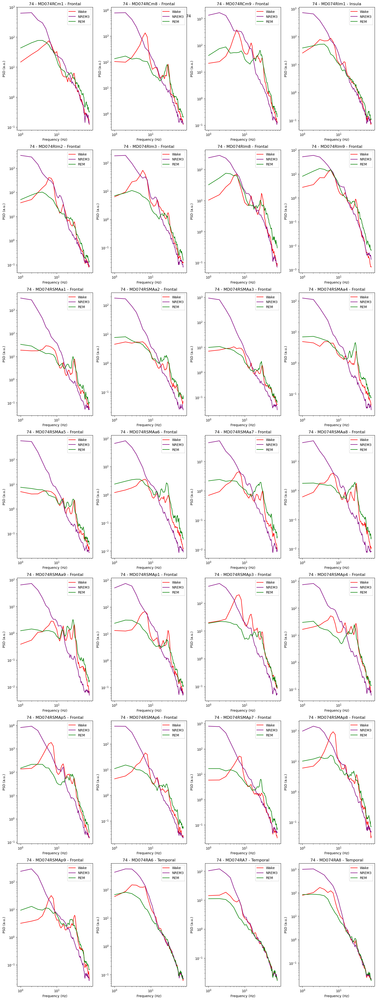

Pat 75


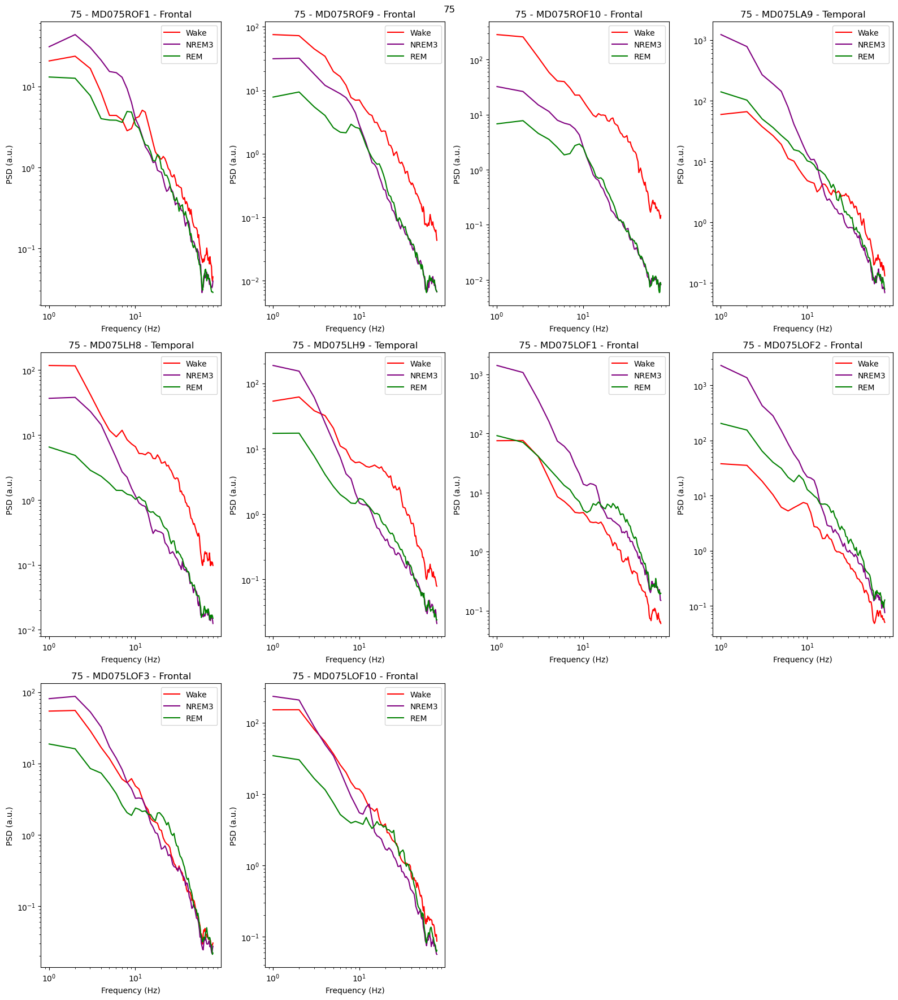

Pat 76


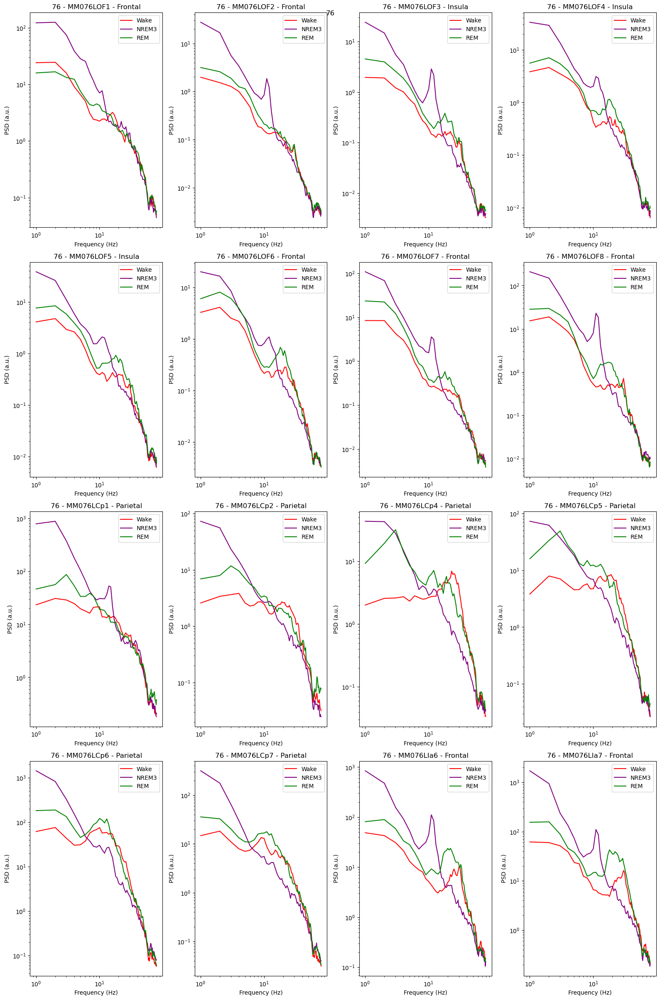

Pat 78


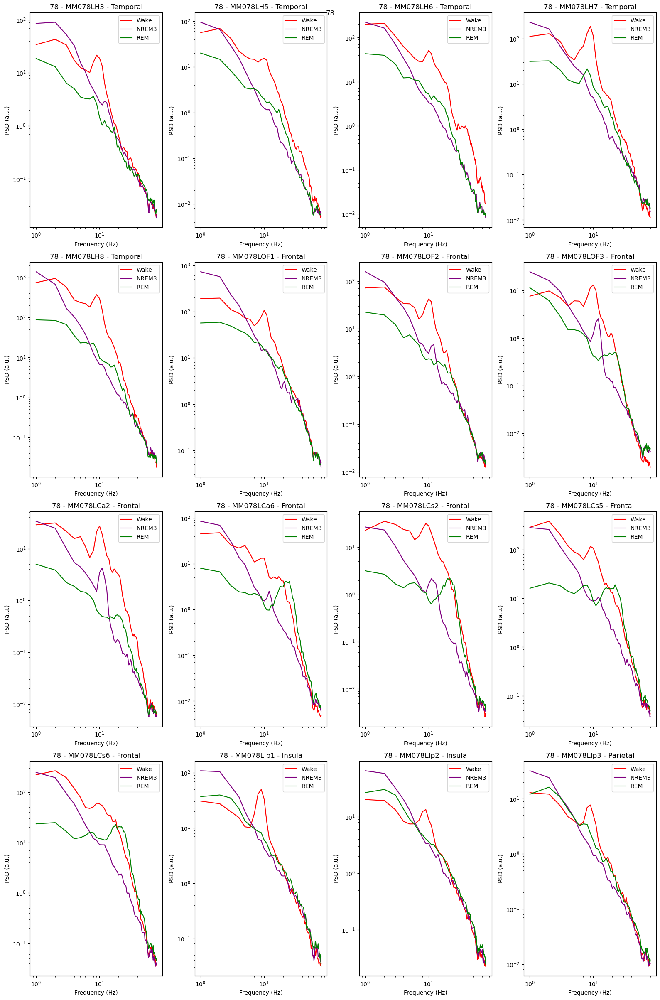

Pat 80


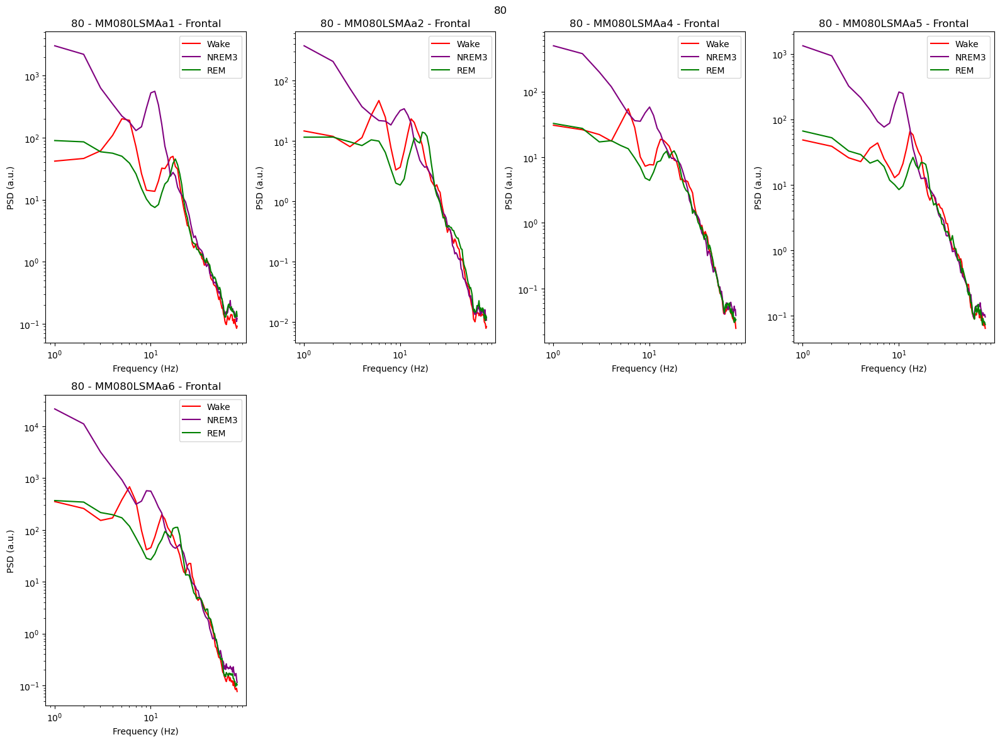

Pat 81


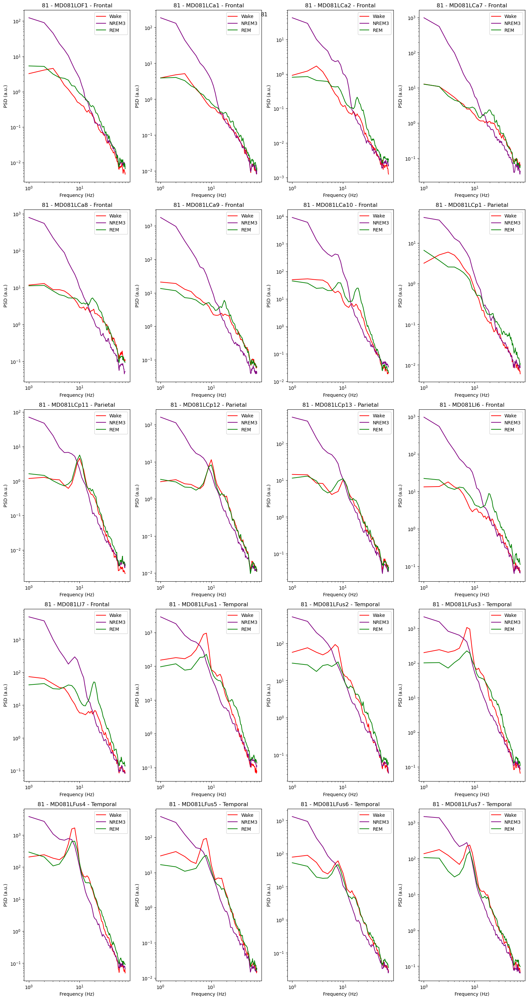

Pat 83


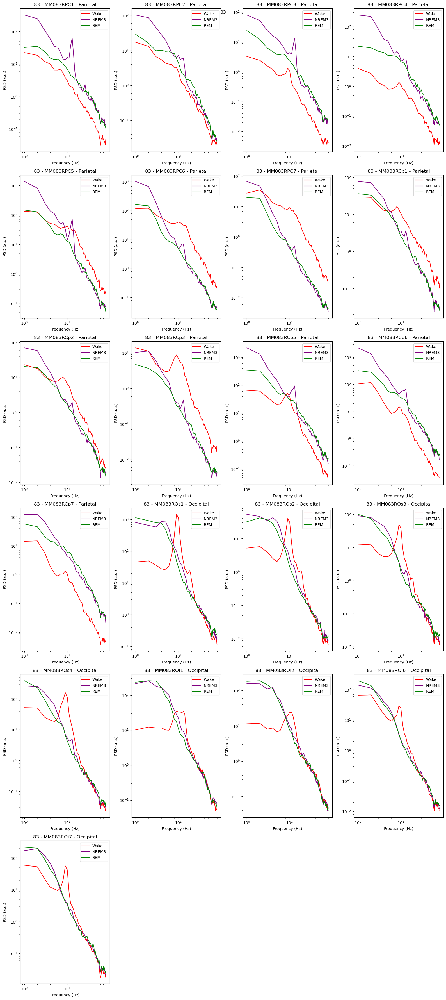

Pat 84


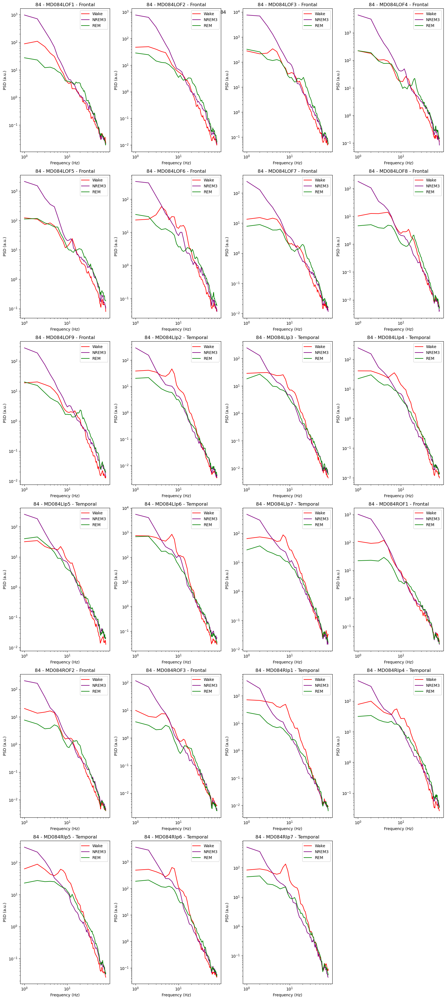

Pat 85


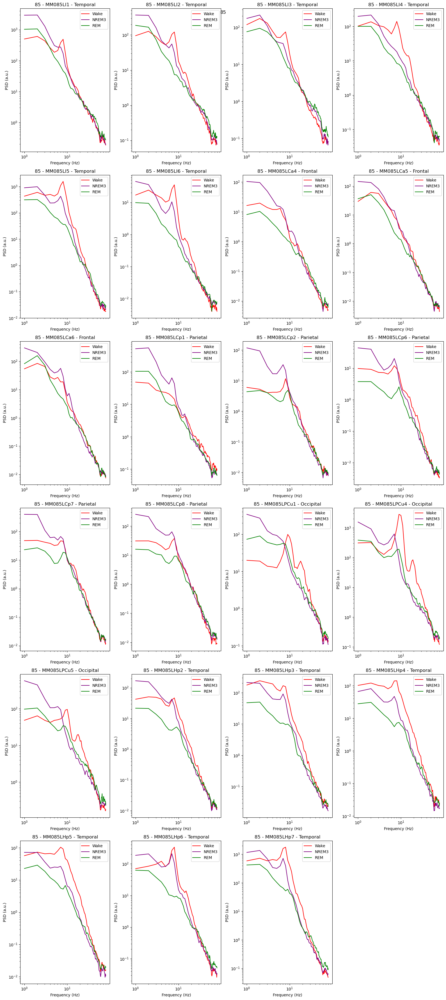

Pat 87


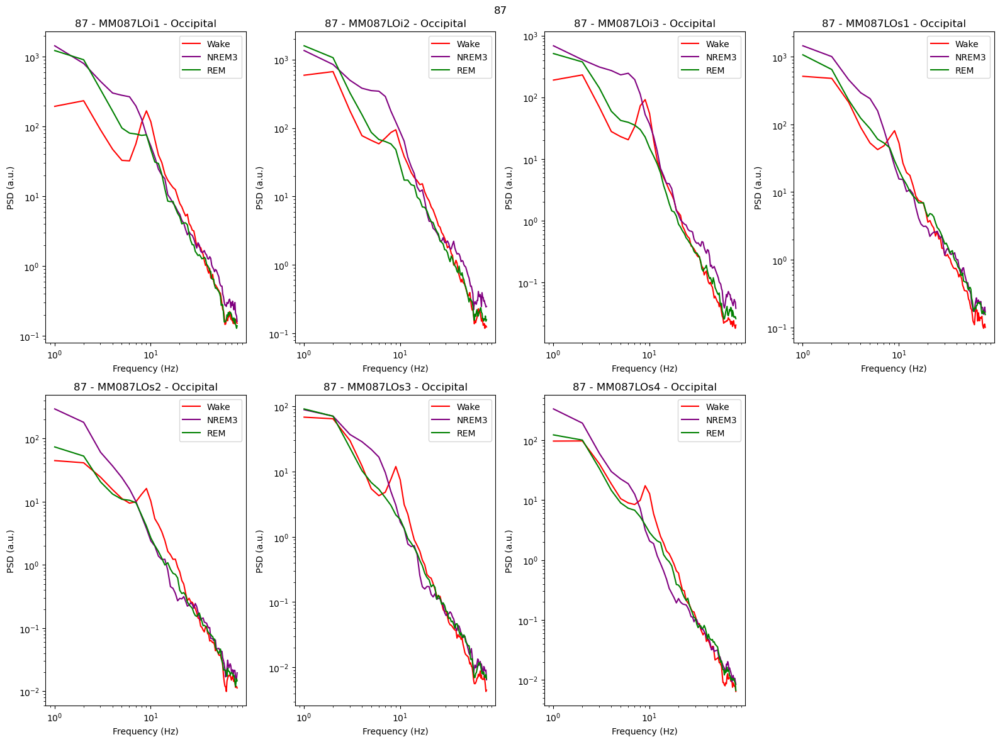

Pat 88


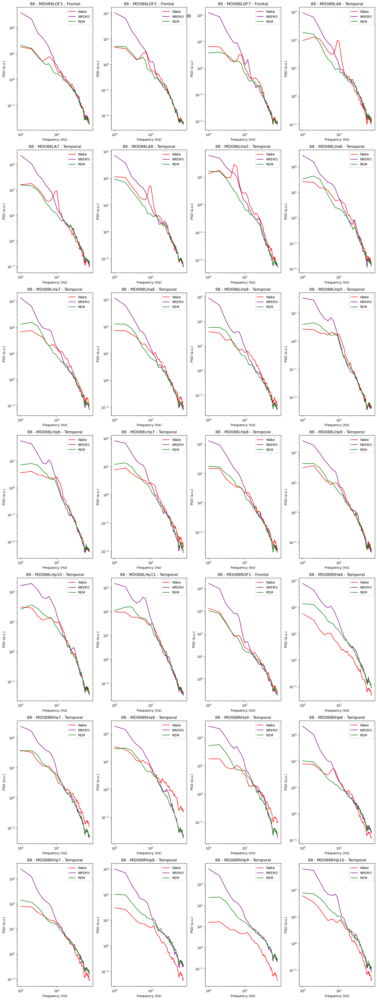

Pat 89


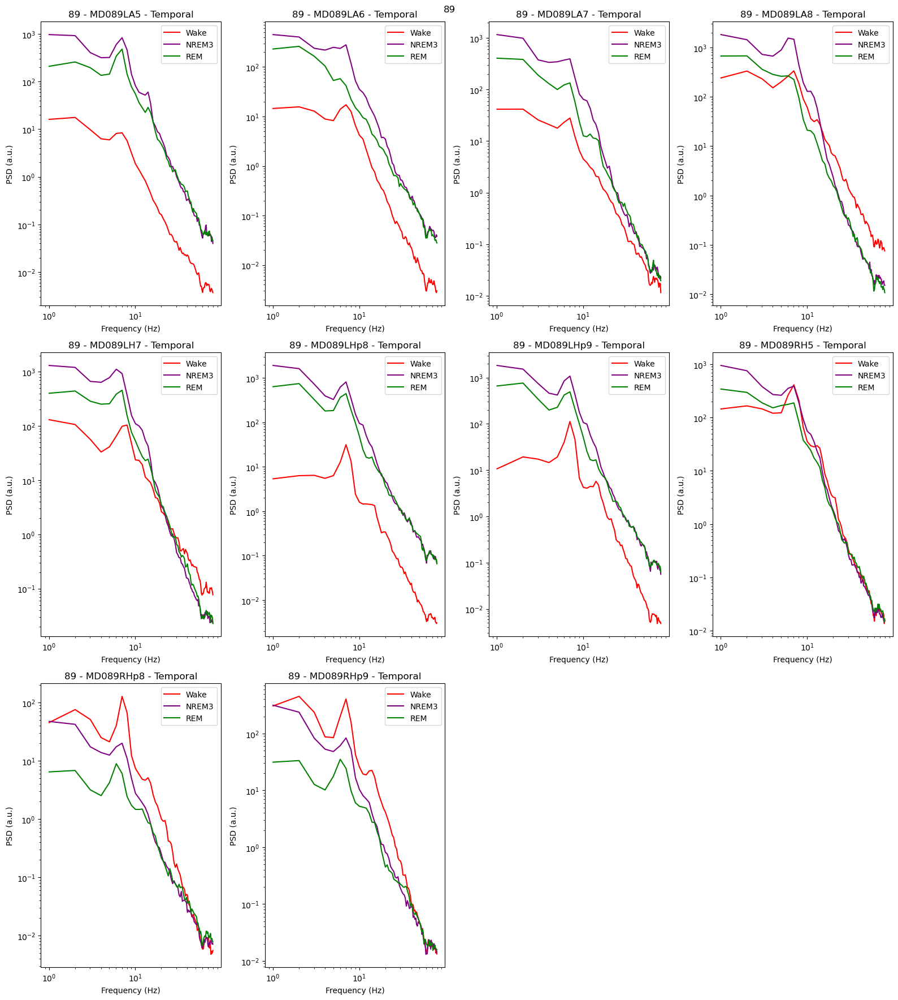

Pat 91


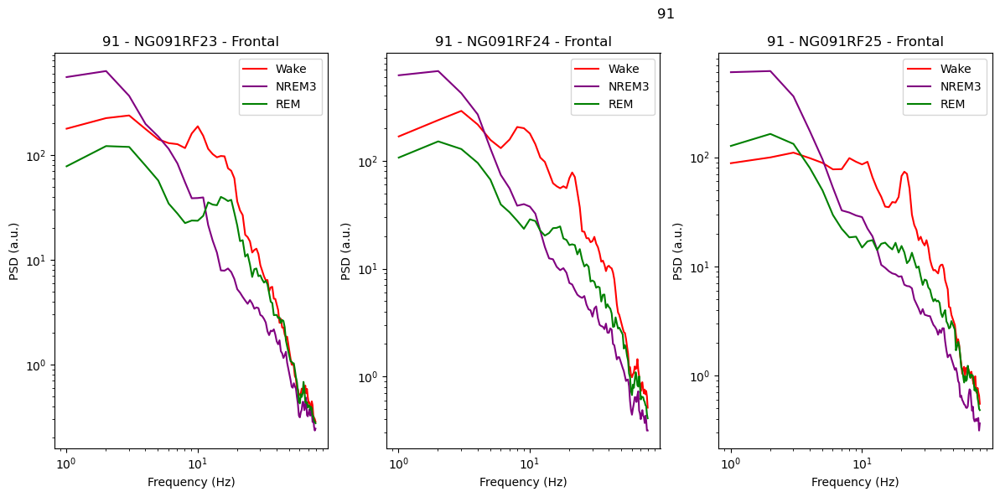

Pat 92


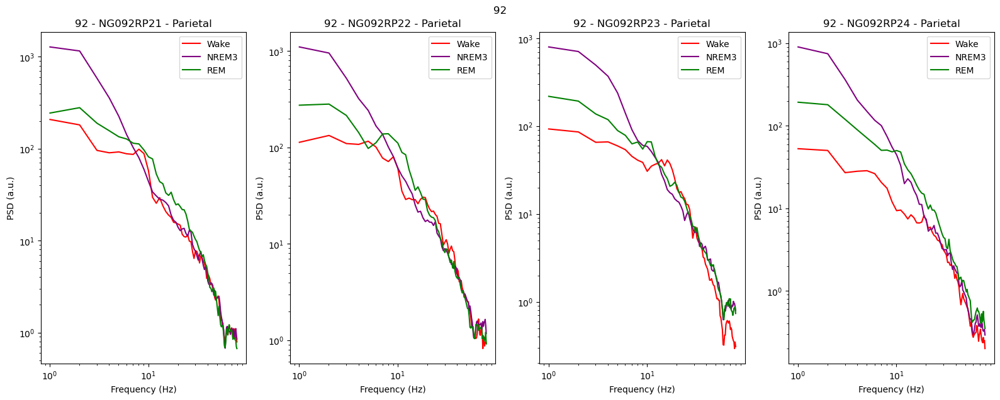

Pat 93


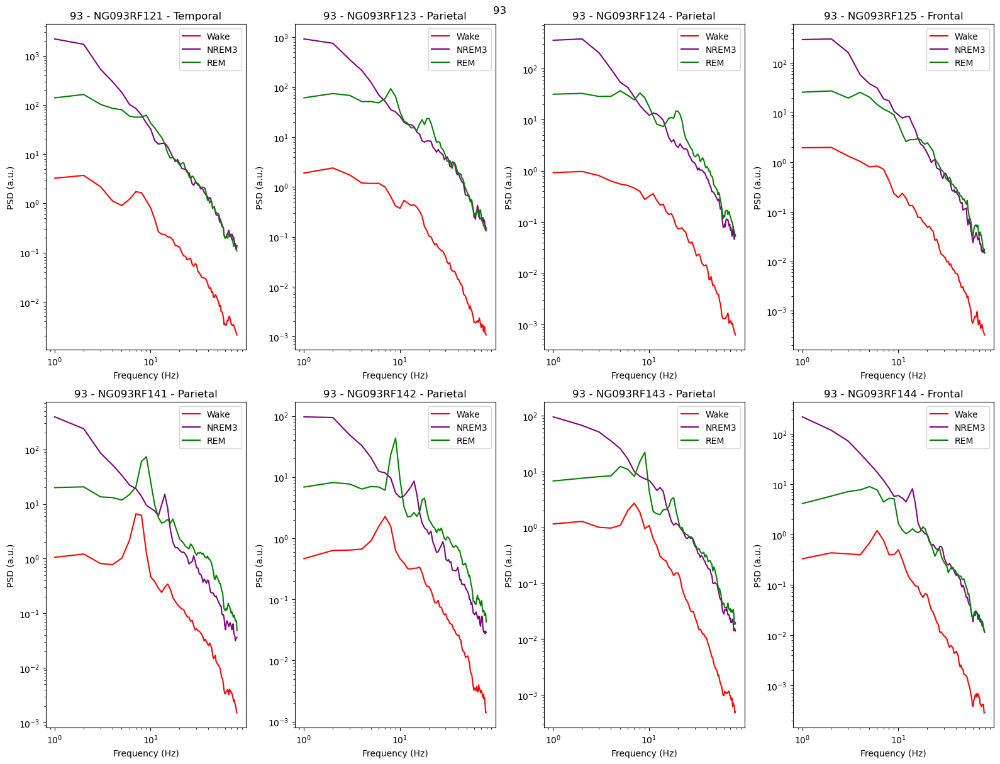

Pat 94


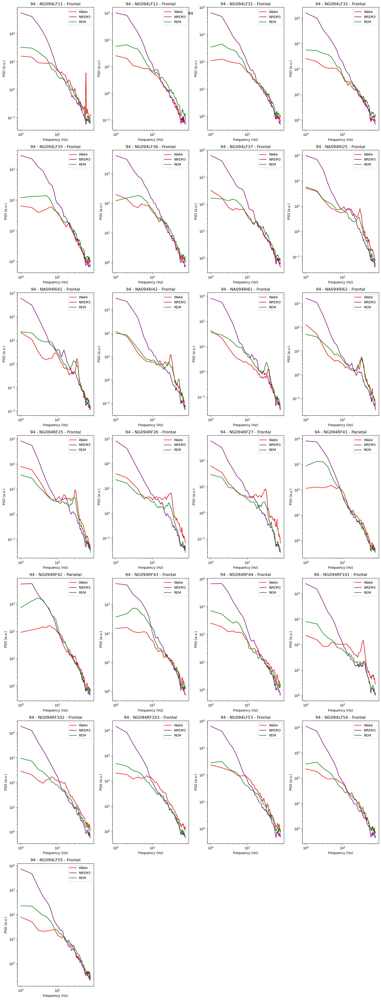

Pat 98


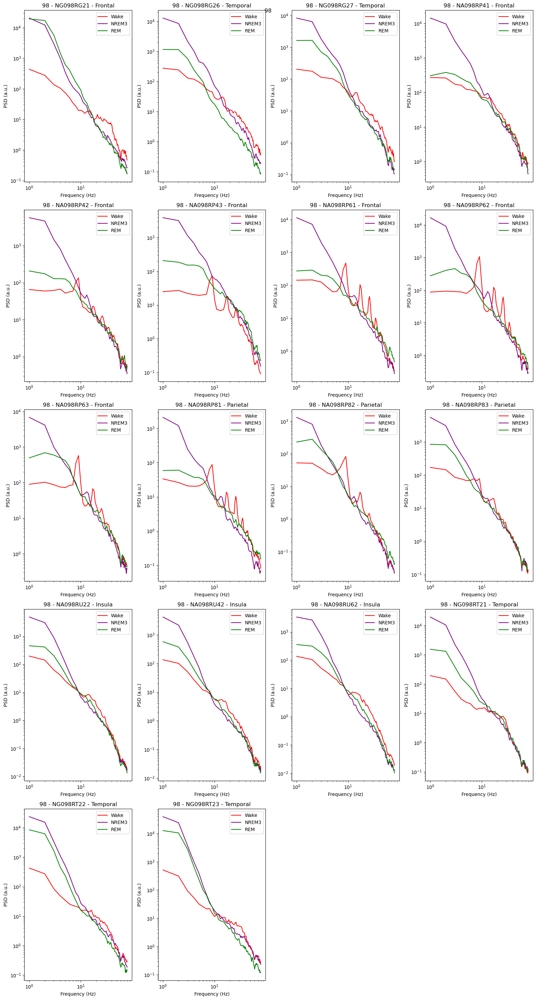

Pat 99


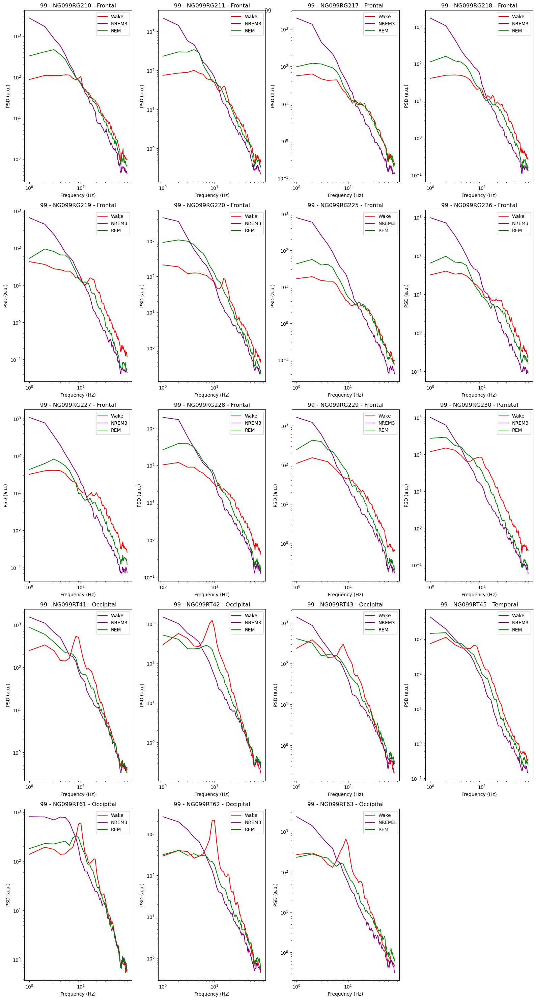

Pat 100


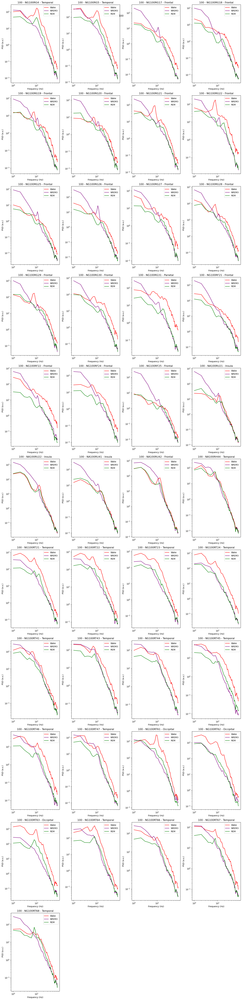

Pat 102


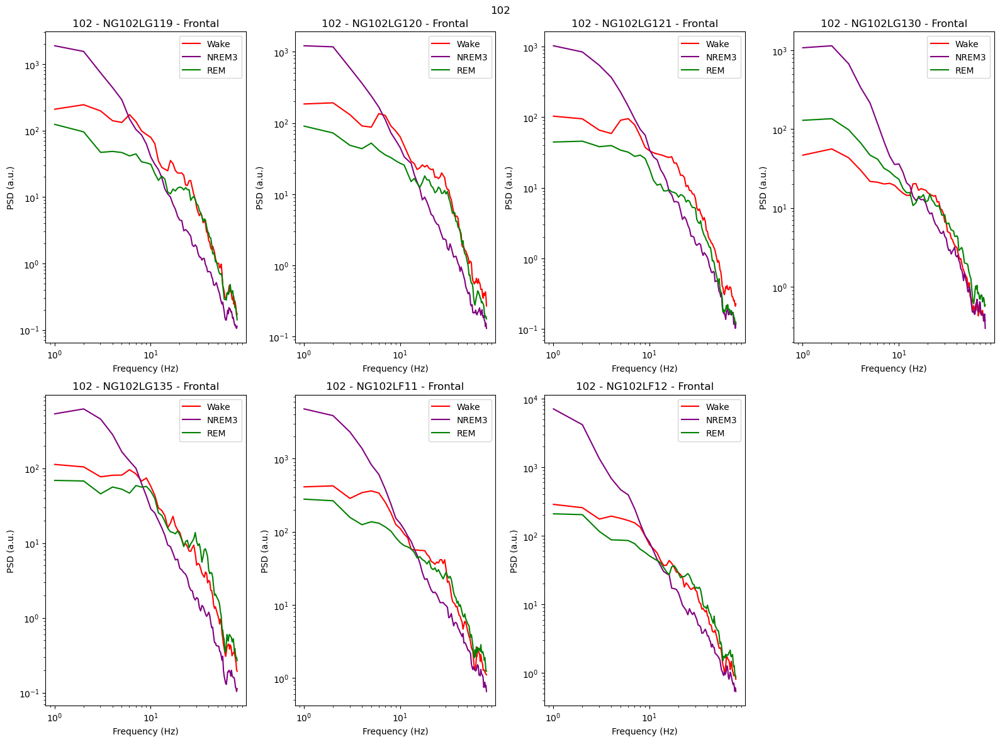

Pat 103


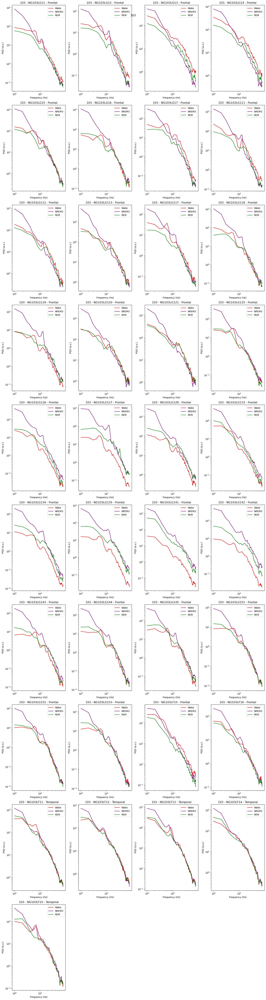

Pat 106


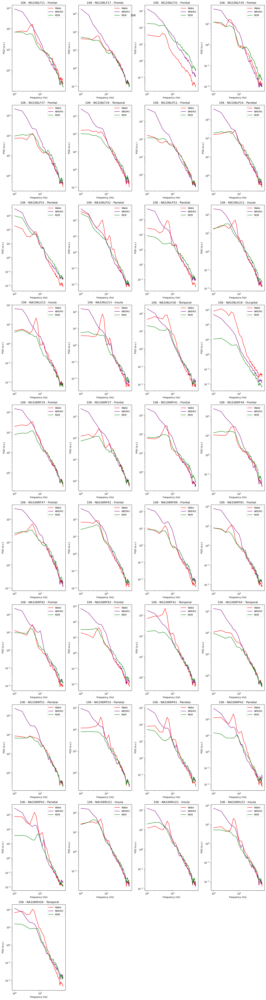

Pat 108


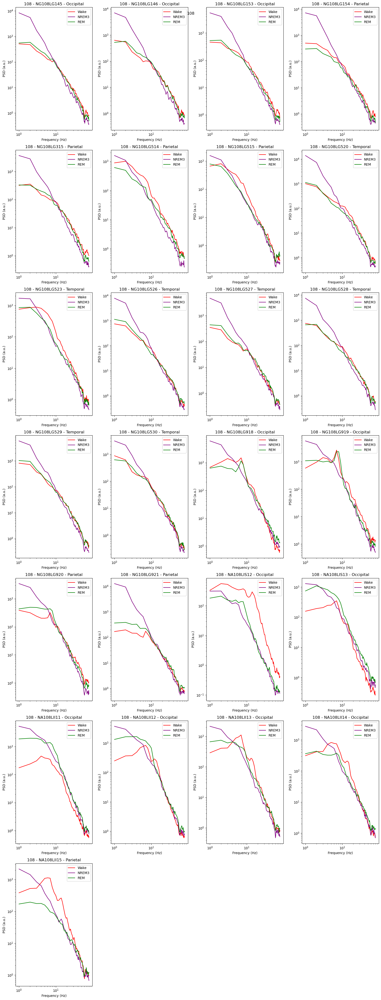

Pat 110


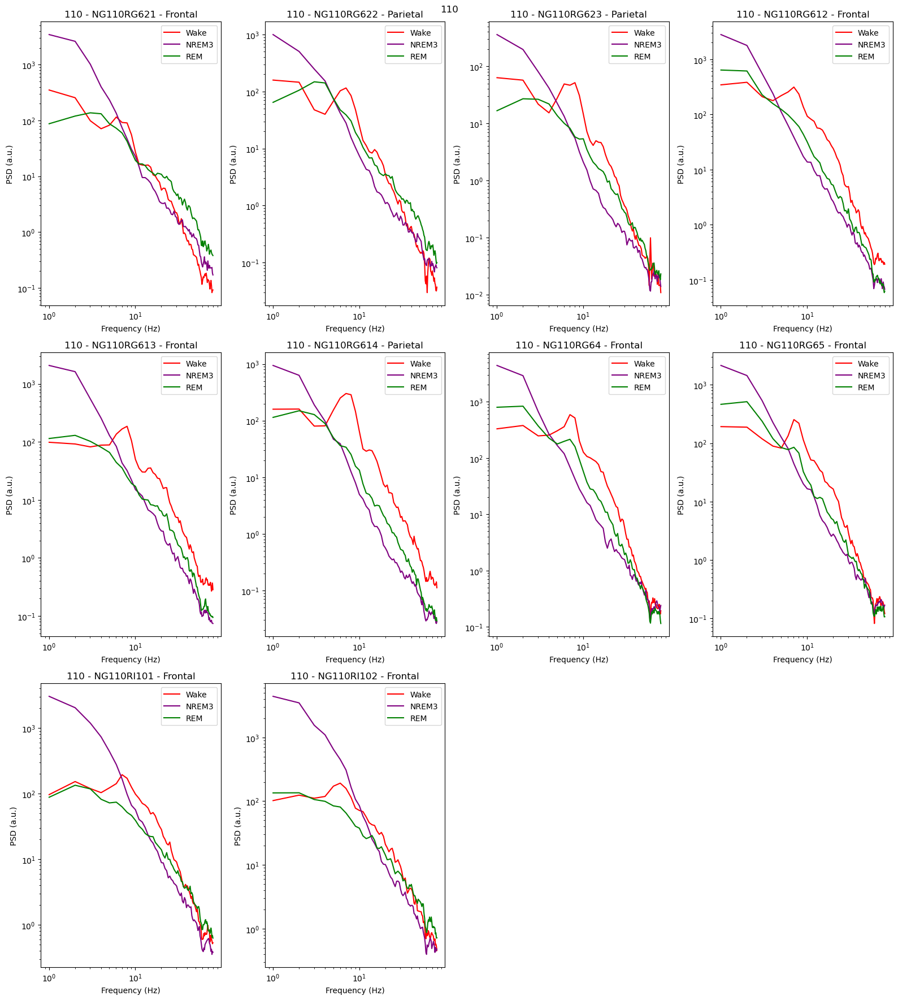

In [42]:
stages_dict = {"W": "Wake", "N3": "NREM3", "R": "REM"}
color_stages = {"W": "red", "N3": "purple", "R": "green"}

for pat in pats_all_stages:
    pat_dir = base_path.joinpath("Results", str(pat).zfill(3))
    print("Pat " + str(pat))
    pat_data = {}
    for stage in ["W", "N3", "R"]:
        with open(
            pat_dir.joinpath("PSD/" + str(pat).zfill(3) + "_" + stage.lower() + ".pkl"),
            "rb",
        ) as f:
            psd_pat_stage = pickle.load(f)
        with open(
            pat_dir.joinpath("ACF/" + str(pat).zfill(3) + "_" + stage.lower() + ".pkl"),
            "rb",
        ) as f:
            acf_pat_stage = pickle.load(f)
        pat_data[stage] = {"psd": psd_pat_stage["psd"], "acf": acf_pat_stage["acf"]}
    pat_data["freqs"] = psd_pat_stage["freqs"]
    pat_data["lags"] = (acf_pat_stage["lags"],)
    pat_data["chans"] = psd_pat_stage["chans"]
    # Figure
    n_cols = 4
    n_rows = len(pat_data["chans"]) // n_cols + 1
    plt.figure(figsize=(n_cols * 4, n_rows * 6))
    plt.suptitle(pat)
    for i, chan in enumerate(pat_data["chans"]):
        plt.subplot(n_rows, n_cols, i + 1)
        for stage in ["W", "N3", "R"]:
            plt.plot(
                pat_data["freqs"],
                pat_data[stage]["psd"][:, i].mean(axis=0),
                c=color_stages[stage],
                label=stages_dict[stage],
            )
        plt.xscale("log")
        plt.yscale("log")
        title = " - ".join(
            [
                str(pat),
                chan,
                df_tau[
                    (df_tau.pat == pat)
                    & (df_tau.chan == chan)
                    & (df_tau.stage == stage)
                ]["lobe"].values[0],
            ]
        )
        plt.title(title)
        plt.xlabel("Frequency (Hz)")
        plt.ylabel("PSD (a.u.)")
        plt.legend()
    plt.tight_layout()
    plt.show()

#### Plot pairs of corresponding PSD / ACF

Pat 41


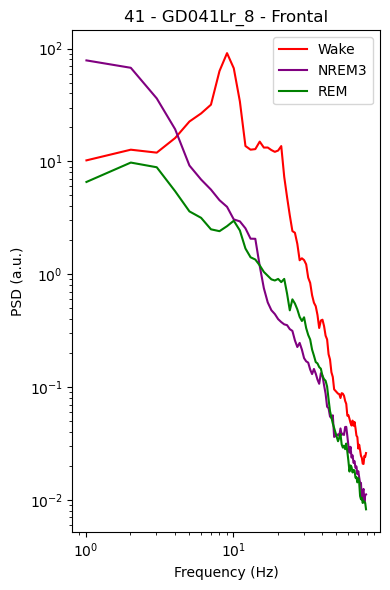

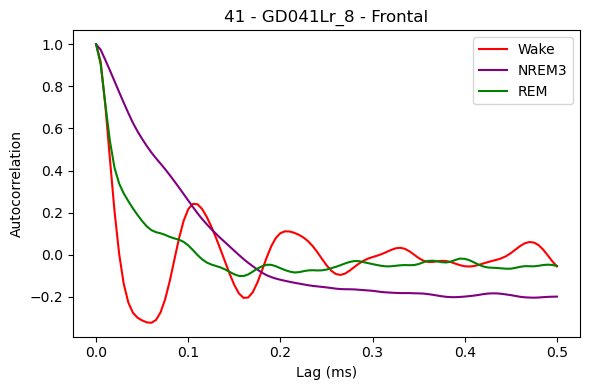

Pat 103


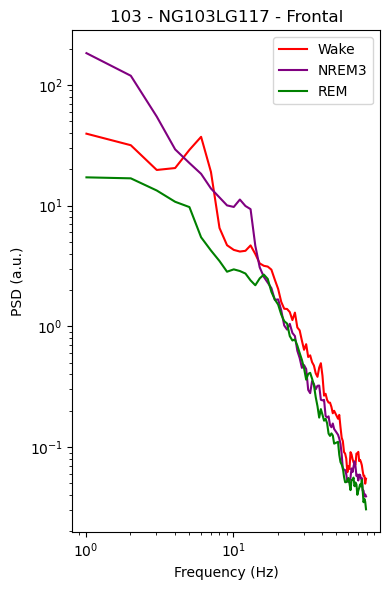

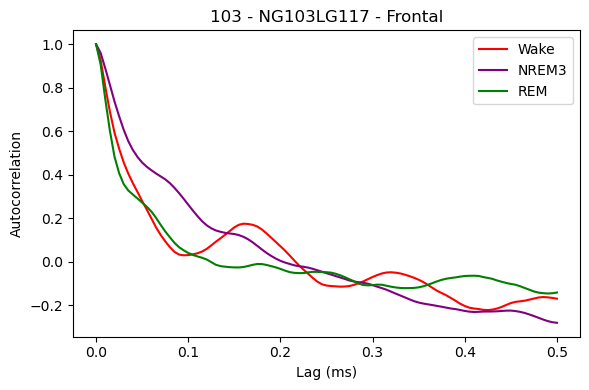

Pat 42


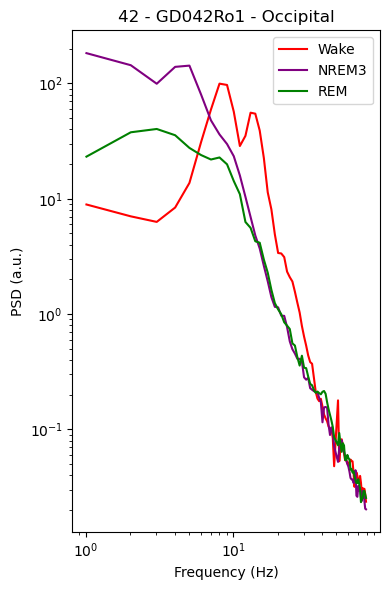

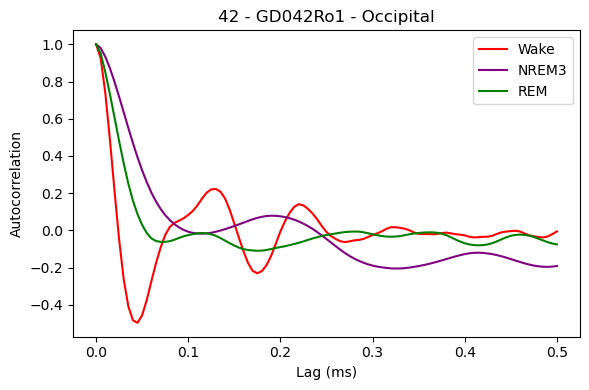

Pat 99


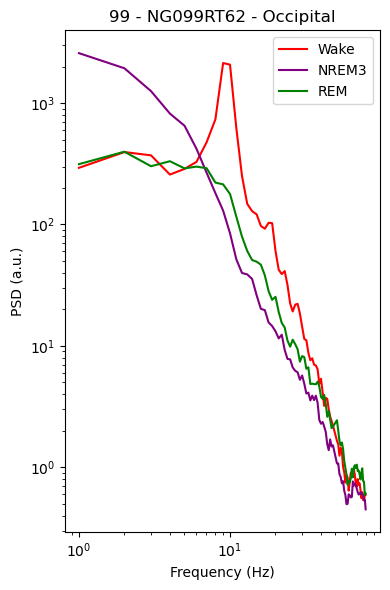

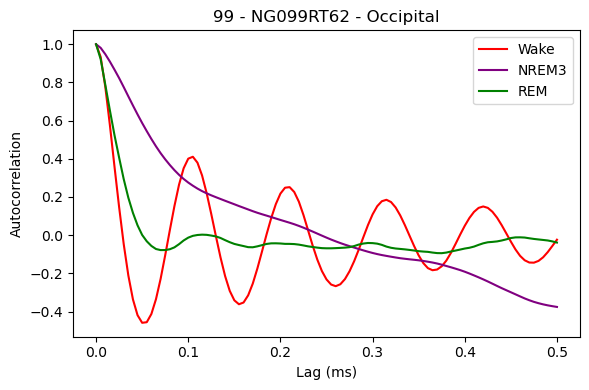

Pat 20


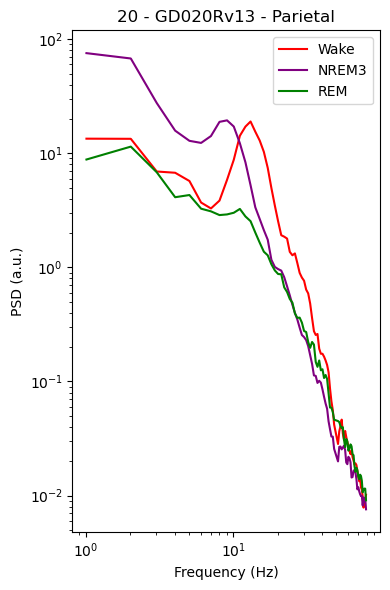

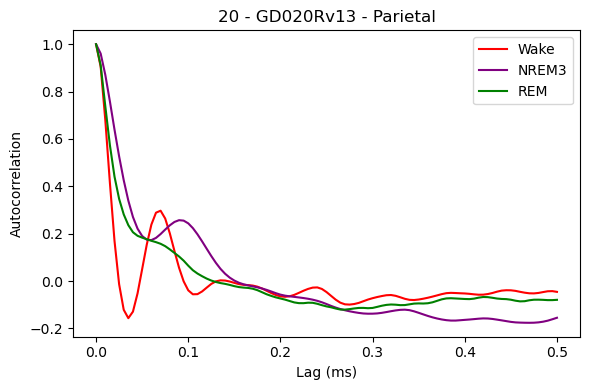

Pat 106


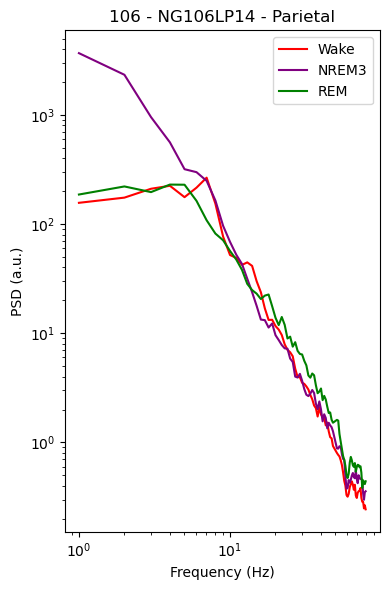

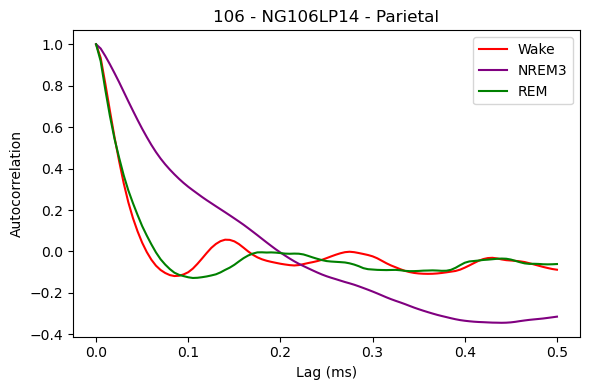

Pat 34


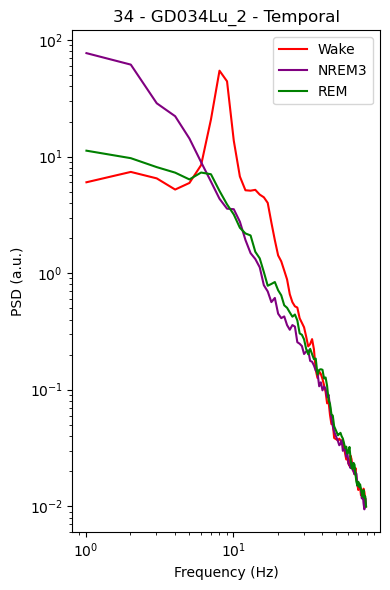

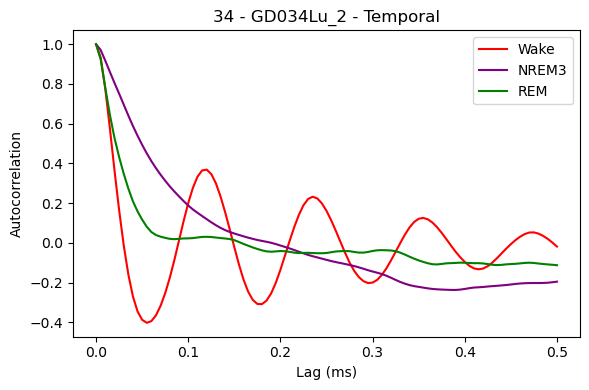

Pat 53


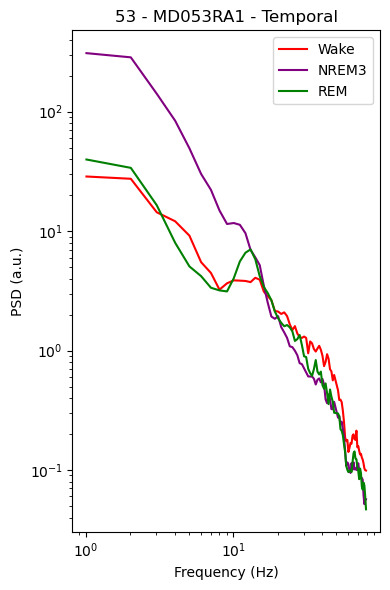

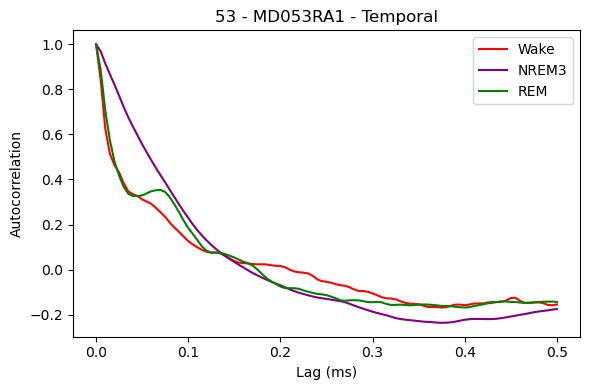

In [46]:
pats = [41, 103, 42, 99, 20, 106, 34, 53]
chans = ["GD041Lr_8", "NG103LG117", "GD042Ro1", "NG099RT62", "GD020Rv13", "NG106LP14", "GD034Lu_2", "MD053RA1"]
lobes = ["Frontal", "Frontal", "Occipital", "Occipital", "Parietal", "Parietal", "Temporal", "Temporal"]

for pat, chan, lobe in zip(pats, chans, lobes):
    pat_dir = base_path.joinpath("Results", str(pat).zfill(3))
    print("Pat " + str(pat))
    pat_data = {}
    for stage in ["W", "N3", "R"]:
        with open(
            pat_dir.joinpath("PSD/" + str(pat).zfill(3) + "_" + stage.lower() + ".pkl"),
            "rb",
        ) as f:
            psd_pat_stage = pickle.load(f)
        with open(
            pat_dir.joinpath("ACF/" + str(pat).zfill(3) + "_" + stage.lower() + ".pkl"),
            "rb",
        ) as f:
            acf_pat_stage = pickle.load(f)
        pat_data[stage] = {"psd": psd_pat_stage["psd"], "acf": acf_pat_stage["acf"]}
    pat_data["freqs"] = psd_pat_stage["freqs"]
    pat_data["lags"] = acf_pat_stage["lags"]
    pat_data["chans"] = psd_pat_stage["chans"]
    # Figure PSD
    plt.figure(figsize=(4, 6))
    idx_chan = pat_data["chans"].index(chan)
    for stage in ["W", "N3", "R"]:
        plt.plot(
            pat_data["freqs"],
            pat_data[stage]["psd"][:, idx_chan].mean(axis=0),
            c=color_stages[stage],
            label=stages_dict[stage],
        )
    plt.xscale("log")
    plt.yscale("log")
    title = " - ".join(
        [
            str(pat),
            chan,
            lobe]
    )
    plt.title(title)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("PSD (a.u.)")
    plt.legend()
    plt.tight_layout()

    # Figure ACF
    plt.figure(figsize=(6, 4))
    idx_chan = pat_data["chans"].index(chan)
    for stage in ["W", "N3", "R"]:
        plt.plot(
            pat_data["lags"],
            pat_data[stage]["acf"][:, idx_chan].mean(axis=0),
            c=color_stages[stage],
            label=stages_dict[stage],
        )
    title = " - ".join(
        [
            str(pat),
            chan,
            lobe
        ]
    )
    plt.title(title)
    plt.xlabel("Lag (ms)")
    plt.ylabel("Autocorrelation")
    plt.legend()
    plt.tight_layout()

    plt.show()